# Notes about simulation:

**Running info**

**EA params**


**Parameter search space**


**Mean of Mean Square Error of the top 2.5% of Individuals** 


# Import packages and set settings

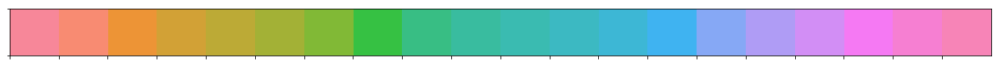

In [2]:
%matplotlib inline
import pathlib
import seaborn as sns
import matplotlib.pyplot as plt
import pickle
import numpy as np
import math
import pandas as pd
from scipy.integrate import odeint
import os

# plt.style.use("seaborn-whitegrid")
plt.rcParams['figure.figsize'] = [10.0, 8.0]
plt.rcParams['axes.titlesize'] = 20
plt.rcParams['axes.labelsize'] = 18
plt.rcParams['xtick.labelsize'] = 14
plt.rcParams['ytick.labelsize'] = 14
plt.rcParams['grid.linestyle'] = '-'
plt.rcParams['legend.fontsize'] = 14
colors = [i['color'] for i in plt.rcParams['axes.prop_cycle']]

sns.palplot(sns.husl_palette(20, l=.7))
palette_husl = sns.husl_palette(20, l=.7)
# palette_husl.as_hex()

# Supporting Functions

In [5]:
def load_csv_data(folder):
    data = []
    for csv in pathlib.Path(folder).glob('*.csv'):
        f_data = pd.read_csv(csv)
        time = f_data['Time'].tolist()
        f_data=f_data.set_index('Time')
        f_data = f_data.mean(axis=1)
        f_data = f_data.tolist()
        data.append(f_data)
    return time, data

def get_closest_tps(scorefxn_time,time):
    idx_closest_time_points = []
    for each_time in scorefxn_time:
        closest_idx = min(range(len(time)),
                          key = lambda i: abs(time[i] - each_time))
        idx_closest_time_points.append(closest_idx)
    return idx_closest_time_points

# def convert_individual(ea_individual, conversion_matrix, number_of_params):
    # copy and get len of individual
    arr_params_conv = np.zeros(number_of_params)#np.copy(arr_parameters)
    len_ind = len(ea_individual)

    # Interp:
    for idx in np.nonzero(conversion_matrix[0])[0]:
        ea_val = ea_individual[idx]
        r_min = conversion_matrix[1][idx]
        r_max = conversion_matrix[2][idx]
        arr_params_conv[idx] = np.interp(ea_val, (0,1), (r_min, r_max))

    # Exponentiate:
    for idx in np.nonzero(conversion_matrix[3])[0]:
        ea_val = arr_params_conv[idx]
        base_val = conversion_matrix[4][idx]
        arr_params_conv[idx] = np.power(base_val, ea_val)

    # arr_params_conv[-4:] = np.round(arr_params_conv[-4:],0)

    return arr_params_conv

def scorefxn2(scorefxn_data, inits, params_constants,
              learned_params, time, scorefxn_time):
    sse_total = 0
#     arr_params_IP = convert_individual(learned_params, arr_conversion_matrix)

    for sig, MAPK_wt_data, MAPK_t100a_data in zip(params_constants[-1], scorefxn_data[0], scorefxn_data[1]):
        params_constants_sig = params_constants[:-1]+[sig]

        for fxn, exp_data in zip([simulate_wt_experiment,simulate_t100a_experiment],[MAPK_wt_data, MAPK_t100a_data]):
            data = fxn(inits, params_constants_sig, learned_params, time)
            active = data[:,2]/params_constants[2]*100
            _scorefxn_data_active = active[[scorefxn_time]]
            error_active = ((exp_data - _scorefxn_data_active)**2).sum()
            sse_total += error_active
    return sse_total/(len(idx_closest_time_points)*len(params_constants[-1])-len(learned_params))

def scorefxn1(scorefxn_data, inits, params_constants,
              learned_params, time, scorefxn_time):
    sse_total = 0
#     arr_params_IP = convert_individual(learned_params, arr_conversion_matrix)

    for sig, MAPK_wt_data, MAPK_t100a_data in zip(params_constants[-1], scorefxn_data[0], scorefxn_data[1]):
        params_constants_sig = params_constants[:-1]+[sig]

        for fxn, exp_data in zip([simulate_wt_experiment,simulate_t100a_experiment],[MAPK_wt_data, MAPK_t100a_data]):
            data = fxn(inits, params_constants_sig, learned_params, time)
            active = data[:,2]/params_constants[2]*100
            _scorefxn_data_active = active[[scorefxn_time]]
            error_active = ((exp_data - _scorefxn_data_active)**2).mean()
            sse_total += error_active
    return sse_total

def molarity_conversion(molecules):
    Na = 6.02214076*10**23
    cell_volume = 44
    return molecules/(Na*cell_volume*10**-15)*1000000

def gather_simulated_data(folder, gen, runs):
    mse = []
    params_from_file = []

    empty_data = 0
    for loaded_data in pathlib.Path(folder).glob('*.pickled'):
        if os.path.getsize(loaded_data) > 0:
            with open(loaded_data, 'rb') as f:
                new_data = pickle.load(f)
                mse.append(np.asarray(new_data[0]))
                params_from_file.append(np.asarray(new_data[1]))
        else:
            empty_data += 1

    top = round((runs-empty_data)*0.05)
    plt_top = round((runs-empty_data)*0.005)      

    new_params = []
    last_mses = []
    for i in range(len(params_from_file)):
        new_params.append(params_from_file[i][gen])
        last_mses.append(mse[i][gen])
    last_mses = np.asarray(last_mses)
#     last_mses = last_mses
    new_params = np.asarray(new_params)
    new_params = new_params.T

    idx_top = last_mses.argsort()[:top]

    top_params = [([new_params[i][x] for i in range(len(new_params))]) for x in idx_top]
    # top_params = []
    # for idx in idx_top:
    #     top_params.append(params_from_file[idx][100])

    print('Best MSE: ' + str(np.min([mse[idx][gen] for idx in idx_top])))
    print('Mean MSE of top 5%: ' + str(np.mean([mse[idx][gen] for idx in idx_top])))
    return idx_top, top_params, top, plt_top, new_params, params_from_file, mse, last_mses

def plt_param_behaviors(mapk_wt_data, mapk_t100a_data, gen, idx_top, plt_top, params_from_file, 
                        params_constants, initals, time):
    plt.clf()
    fig, (ax1,ax2) = plt.subplots(2, 1, figsize=(12,18))


    # plot 1
    title_text = 'Gen ' + str(gen) + ' fit to WT'
    ax1.set_title(title_text, fontsize=20)
    ax1.set_xlabel('Time', fontsize=20)
    plt.rc('xtick', labelsize=20) 
    plt.rc('ytick', labelsize=20)
    color_palette = ['#000000','#606060','#ff0000','#FF8C00','#008000','#0000FF','#800080']
    
    for idx, wt_data in enumerate(mapk_wt_data):
        ax1.plot(mapk_time, wt_data, 'o', markersize=10, color=color_palette[idx])
        
    # plot 2
    title_text = 'Gen ' + str(gen) +  ' fit to T100A + inhib'
    ax2.set_title(title_text, fontsize=20)
    ax2.set_xlabel('Time', fontsize=20)
    
    for idx, t100a_data in enumerate(mapk_t100a_data):
        ax2.plot(mapk_time, t100a_data, '^', mew=2, markersize=10, color=color_palette[idx])

    # ax2.legend(bbox_to_anchor=[1, 0.5], loc='center left')    
    
    # plot evolutionary algorithm data on plots 1 and 2:
    unstable_wt = 0
    unstable_t100a = 0
    for idx in idx_top[:plt_top]:
        learned_params = params_from_file[idx][gen]
        for idx, sig in enumerate(params_constants[-1]):
            params_c = params_constants[:-1]+[sig]
            data = simulate_wt_experiment(initals, params_c, learned_params, time)
            active = data[:,2]/params_constants[2]*100
            if len([*filter(lambda x: x <= 100, active)]) == len(active) and len([*filter(lambda x: x >= 0, active)]) == len(active):
                ax1.plot(time, active, color=color_palette[idx])
            else:
                unstable_wt += 1
            data = simulate_t100a_experiment(initals, params_c, learned_params, time)
            active = data[:,2]/params_constants[2]*100
            if len([*filter(lambda x: x <= 100, active)]) == len(active) and len([*filter(lambda x: x >= 0, active)]) == len(active):
                ax2.plot(time, active, color=color_palette[idx])
            else:
                unstable_t100a += 1
    print('# of unstable WT experiments: ' + str(unstable_wt) + ' of ' + str(plt_top*6))
    print('# of unstable T100A experiments: ' + str(unstable_t100a) + ' of ' + str(plt_top*6))
    # ax1.legend(bbox_to_anchor=[1, 0.5], loc='center left')
    plt.show()

def plt_param_behaviors_map2k(mapk_wt_data, mapk_t100a_data, gen, idx_top, plt_top, params_from_file, 
                        params_constants, initals, time):
    plt.clf()
    fig, (ax1,ax2) = plt.subplots(2, 1, figsize=(12,18))


    # plot 1
    title_text = 'Gen ' + str(gen) + ' fit to WT'
    ax1.set_title(title_text, fontsize=20)
    ax1.set_xlabel('Time', fontsize=20)
    plt.rc('xtick', labelsize=20) 
    plt.rc('ytick', labelsize=20)
    color_palette = ['#000000','#606060','#ff0000','#FF8C00','#008000','#0000FF','#800080']
    
    for idx, wt_data in enumerate(mapk_wt_data):
        ax1.plot(mapk_time, wt_data, 'o', markersize=10, color=color_palette[idx])
        
    # plot 2
    title_text = 'Gen ' + str(gen) +  ' fit to T100A + inhib'
    ax2.set_title(title_text, fontsize=20)
    ax2.set_xlabel('Time', fontsize=20)
    
    for idx, t100a_data in enumerate(mapk_t100a_data):
        ax2.plot(mapk_time, t100a_data, '^', mew=2, markersize=10, color=color_palette[idx])

    # ax2.legend(bbox_to_anchor=[1, 0.5], loc='center left')    
    
    # plot evolutionary algorithm data on plots 1 and 2:
    unstable_wt = 0
    unstable_t100a = 0
    for idx in idx_top[:plt_top]:
        learned_params = params_from_file[idx][gen]
        for idx, sig in enumerate(params_constants[-1]):
            params_c = params_constants[:-1]+[sig]
            data = simulate_wt_experiment(initals, params_c, learned_params, time)
            active = data[:,1]/params_constants[1]*100
            if len([*filter(lambda x: x <= 100, active)]) == len(active) and len([*filter(lambda x: x >= 0, active)]) == len(active):
                ax1.plot(time, active, color=color_palette[idx])
            else:
                unstable_wt += 1
            data = simulate_t100a_experiment(initals, params_c, learned_params, time)
            active = data[:,1]/params_constants[1]*100
            if len([*filter(lambda x: x <= 100, active)]) == len(active) and len([*filter(lambda x: x >= 0, active)]) == len(active):
                ax2.plot(time, active, color=color_palette[idx])
            else:
                unstable_t100a += 1
    print('# of unstable WT experiments: ' + str(unstable_wt) + ' of ' + str(plt_top*6))
    print('# of unstable T100A experiments: ' + str(unstable_t100a) + ' of ' + str(plt_top*6))
    # ax1.legend(bbox_to_anchor=[1, 0.5], loc='center left')
    plt.show()
    
    #plot3 
def plt_mses_gen(gen,mse):
    plt.clf()
    fig, (ax3) = plt.subplots(1, 1, figsize=(12,8))
    colors2 = sns.color_palette("Greys", 20)[10:]
    pal2 = sns.set_palette(colors2)
    ax3.set_xlabel('Generation', fontsize=20)
    for idx in idx_top:#range(1000)
        ax3.semilogy([x for x in range(gen)], mse[idx][:gen])
    ax3.yaxis.grid(True)
    ax3.set_ylabel('SSE', fontsize=20)
    ax3.set_xlim([0,gen])
#     ax3.set_ylim([10**3,10**5])
    plt.show()
    

def plot_param_ranges(colors3, labelnames, diff, minimums, df_top_params_log_M):
    plt.rcParams['figure.figsize'] = [12.0, 8.0]

    pal3 = sns.set_palette(colors3)

    with sns.axes_style("whitegrid"):
        plt.bar(range(0,len(labelnames)),height=diff,bottom=minimums,align='center',tick_label=labelnames, color='#DCDCDC',alpha = 0.5)
        x = sns.swarmplot(x='param',y='vals', data = df_top_params_log_M)
        x.set_xticklabels(labelnames,rotation=45)
    #     ax.set_yscale("log")
    #     ax.set_ylim(0.00001,100000)
    #     ax4.set_xticks(locs)
    #     plt.xticklabels(labelnames, fontsize=18, rotation=90)
        plt.xlabel('Parameters', fontsize=20)
        plt.ylabel('Learned parameter values (base 10)', fontsize=20)
    #     ax.yaxis.set_major_locator(ticker.MultipleLocator(2))
        plt.show()
        

def plot_mses(labelnames, mses, top_p, colors, title):
    mses = [x.copy() for x in mses]
    top = len(mses[0])*top_p
    top_mses = [np.sort(x)[:int(top)] for x in mses]
    df_mses = pd.DataFrame(top_mses).T
    df_mses.columns = labelnames
    df_mses_M = df_mses.melt(var_name='model', value_name='vals')

    pal = sns.set_palette(colors)
    with sns.axes_style("whitegrid"):
        x = sns.swarmplot(x='model',y='vals', data = df_mses_M)
        x.set_xticklabels(labelnames,rotation=45)
    #     ax.set_yscale("log")
    #     ax.set_ylim(0.00001,100000)
    #     ax4.set_xticks(locs)
    #     plt.xticklabels(labelnames, fontsize=18, rotation=90)
        plt.xlabel('Models', fontsize=20)
        plt.ylabel('SSE', fontsize=20)
    #     ax.yaxis.set_major_locator(ticker.MultipleLocator(2))
        plt.title('SSE of the top '+ str(int(top_p*100)) + '% of parameter sets')
#     plt.savefig("C:/Users/sksuzuki/Documents/Research/presentations/lab_meetings/Figures/"+title+".png",dpi=300)
#         plt.show()

# def get_synthdata(data, ):
    
def get_synth_data_params(opt_data_mapk,wt_data_synth,top_params,num):
    opt_tps = list(itertools.chain.from_iterable(opt_data.values()))
    smse = []
    for params in top_params[:num]:
        smse_total = 0
        #     arr_params_IP = convert_individual(learned_params, arr_conversion_matrix)

        for sig, tps, MAPK_wt_data in zip(list(opt_data.keys()), list(opt_data.values()), wt_data_synth):
            params_constants_sig = params_constants[:-1]+[sig]
            for fxn in [simulate_wt_experiment]:
                data = fxn(initals, params_constants_sig, params, tps)
                active = data[:,2]/params_constants[2]*100
        #         print(MAPK_wt_data, active)
                error_active = ((MAPK_wt_data - active)**2).mean()
                smse_total += error_active
                if sig == 550000:
                    data = fxn(initals, params_constants_sig, params, mapk_time)
                    map2k = data[:,1]/params_constants[1]*100
                    if any(x > 20 for x in map2k):
    #                     print(map2k)
                        continue
                    else:
                        smse_total += 5000
        smse.append(smse_total)
    idx_synth_param = sorted(range(len(smse)), key=lambda k: smse[k])
    return top_params[idx_synth_param[0]]

# Load data to fit to

In [7]:
wt_folder = 'C:/Users/sksuzuki/Desktop/killdevil/data/MAPK activation/WT'
t100a_folder = 'C:/Users/sksuzuki/Desktop/killdevil/data/MAPK activation/T100A'

def load_csv_data(folder):
    data = []
    for csv in pathlib.Path(folder).glob('*.csv'):
        f_data = pd.read_csv(csv)
        time = f_data['Time'].tolist()
        f_data=f_data.set_index('Time')
        f_data = f_data.mean(axis=1)
        f_data = f_data.tolist()
        data.append(f_data)
    return time, data

mapk_time, mapk_wt_data = load_csv_data(wt_folder)
mapk_time, mapk_t100a_data = load_csv_data(t100a_folder)

scorefxn_data = [mapk_wt_data, mapk_t100a_data]

# Synthetic Data

In [8]:
def open_synth_data(filename):
    scorefxn_arr = pickle.load(open(filename, 'rb'))
    scorefxn_time, scorefxn_data = scorefxn_arr 

    fig, (ax1,ax2) = plt.subplots(2, 1, figsize=(8,8))
    # use_consistent_colors = ['b','g']
    for strain,dash in zip(scorefxn_data[:2], ['-','--']):
        for idx, exp in enumerate(strain):
            ax1.plot(scorefxn_time, exp, dash, markersize=10)#,color=color_palette[idx])
    #     print(len(strain))
    ax1.grid()
#     plt.show()
    for strain,dash in zip(scorefxn_data[2:4], ['-','--']):
        for idx, exp in enumerate(strain):
            ax2.plot(scorefxn_time, exp, dash, markersize=10)#,color=color_palette[idx])
    #     print(len(strain))
    ax2.grid()
    plt.show()
    return scorefxn_time, scorefxn_data

# One step delay - a1

## Functions

In [57]:
def b3_a1_1D(initals,t,params_constants,params):
    MAP3K, MAP2K, MAPK, X = initals
    MAP3K_t, MAP2K_t, MAPK_t, s = params_constants
    beta_3, alpha_1, k1, k3, k5, s7, k2, k4, k6, d8, K_1, K_3, K_5, K_2, K_4, K_6 = params

    MAP3K_I = MAP3K_t-MAP3K
    MAP2K_I = MAP2K_t-MAP2K
    MAPK_I = MAPK_t-MAPK
    # Y_I = Y_t-Y

    dMAP3K = (s/(1+X/beta_3)) * (((k1)*MAP3K_I)/(K_1+MAP3K_I)) - (k2*MAP3K/(K_2+MAP3K))
    dMAP2K = (((k3*MAP3K)*MAP2K_I)/(K_3+MAP2K_I)) - (k4*MAP2K/(K_4+MAP2K))
    dMAPK = (((k5*MAP2K+alpha_1*MAPK)*MAPK_I)/(K_5+MAPK_I)) - (k6*MAPK/(K_6+MAPK))
    dX = s7*MAPK - d8*X

    return dMAP3K, dMAP2K, dMAPK, dX

def simulate_wt_experiment(inits, params_constants, learned_params, time):
    # parameters to be learned - inits
    # parameters to be kept constant - params_constants
    # parameters to be learned - learned_params

    #solve odes:
    odes = odeint(b3_a1_1D, inits, time, args=(params_constants, learned_params))

    return odes

def simulate_t100a_experiment(inits, params_constants, learned_params, time):
    # parameters to be learned - inits
    # parameters to be kept constant - params_constants
    # parameters to be learned - learned_params
    beta_3, alpha_1, k1, k3, k5, s7, k2, k4, k6, d8, K_1, K_3, K_5, K_2, K_4, K_6  = learned_params
    learned_params = beta_3, 0, k1, k3, k5, 0, k2, k4, k6, d8, K_1, K_3, K_5, K_2, K_4, K_6
    #solve odes:
    odes = odeint(b3_a1_1D, inits, time, args=(params_constants, learned_params))

    return odes

## Inputs

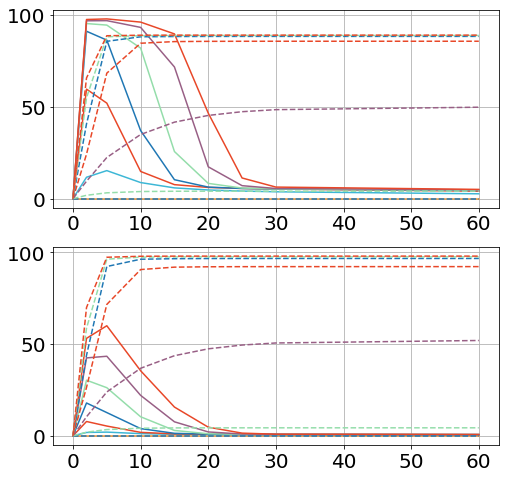

In [58]:
filename = 'C:/Users/sksuzuki/Desktop/killdevil/from/scripts/synth_deg/2_synthdata/map2k/map2k_synthdata/b3_1D_a1_map2k_SYNTH.pickled'
scorefxn_time, scorefxn_data = open_synth_data(filename)
mapk_wt_data = scorefxn_data[0]
mapk_t100a_data = scorefxn_data[1]
map2k_wt_data = scorefxn_data[2]
map2k_t100a_data = scorefxn_data[3]

In [59]:
folder = 'C:/Users/sksuzuki/Desktop/killdevil/from/scripts/181130_b3_1D_a1_map2k_SYNTH/'

gen = 5000
runs = 2000

MAP3K = 0
MAP2K = 0
MAPK = 0
X = 0

MAP3K_t = molarity_conversion(1170)
MAP2K_t = molarity_conversion(2282)
MAPK_t = molarity_conversion(5984)


s = [0, 50000, 150000, 250000, 350000, 450000, 550000]


labelnames = ['B3', 'A1',
              'k1', 'k3', 'k5', 's7',
              'k2', 'k4', 'k6', 'd8',
              'K1', 'K3', 'K5', 
              'K2', 'K4', 'K6'
                ]

minimums = [-8, -4,
    -4, -4, -4, -4,
    -4, -4, -4, -4,
    -4, -4, -4,
    -4, -4, -4]

maximums = [ 2, 4,
    4, 4, 4, 4,
    4, 4, 4, 4,
    4, 4, 4,
    4, 4, 4]
diff = np.asarray(maximums)-np.asarray(minimums)

# fb = 1
# t100a_fb = 0

initals = [MAP3K, MAP2K, MAPK, X]
params_constants = [MAP3K_t, MAP2K_t, MAPK_t, s] 
    
dt = 0.1
steps = 600
time = np.linspace(0,dt*steps,steps)

idx_closest_time_points = get_closest_tps(mapk_time,time)

## Gather simulated data

In [60]:
idx_top, top_params, top, plt_top, new_params, params_from_file, mse, last_mses = gather_simulated_data(folder, gen, runs)
df_top_params = pd.DataFrame(top_params)
df_top_params.columns = labelnames
df_top_params_log = df_top_params.apply(np.log10)
df_top_params_log_M = df_top_params_log.melt(var_name='param', value_name='vals')

Best MSE: 127.24897601926583
Mean MSE of top 5%: 513.735440339493


## Plot

# of unstable WT experiments: 0 of 60
# of unstable T100A experiments: 0 of 60


<Figure size 864x576 with 0 Axes>

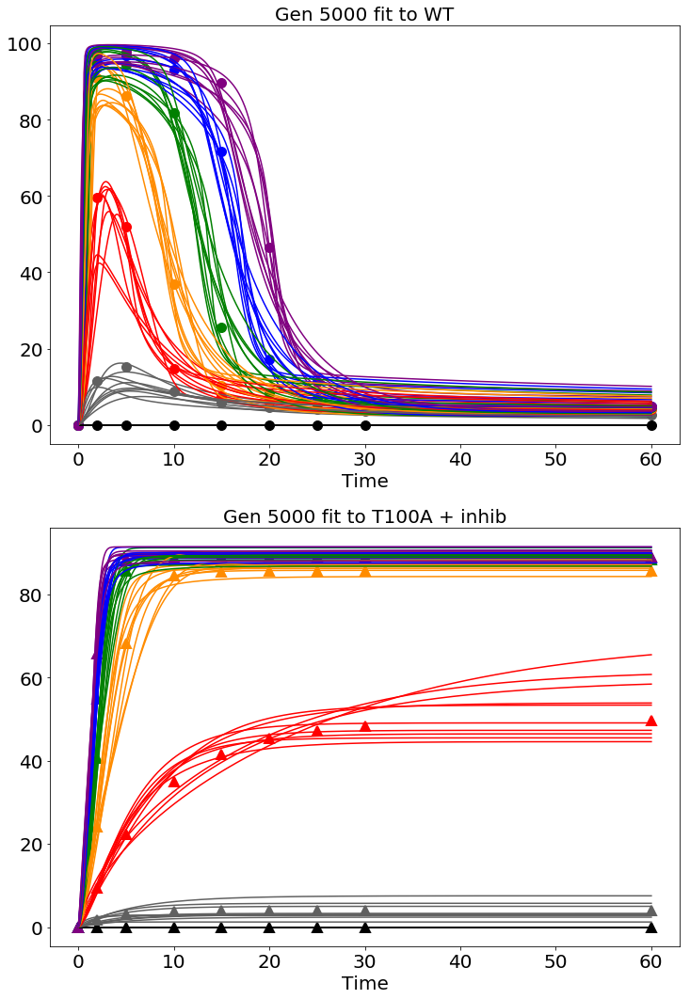

In [61]:
plt_param_behaviors(mapk_wt_data, mapk_t100a_data, gen, idx_top, plt_top, params_from_file, 
                        params_constants, initals, time)

# of unstable WT experiments: 0 of 60
# of unstable T100A experiments: 0 of 60


<Figure size 864x576 with 0 Axes>

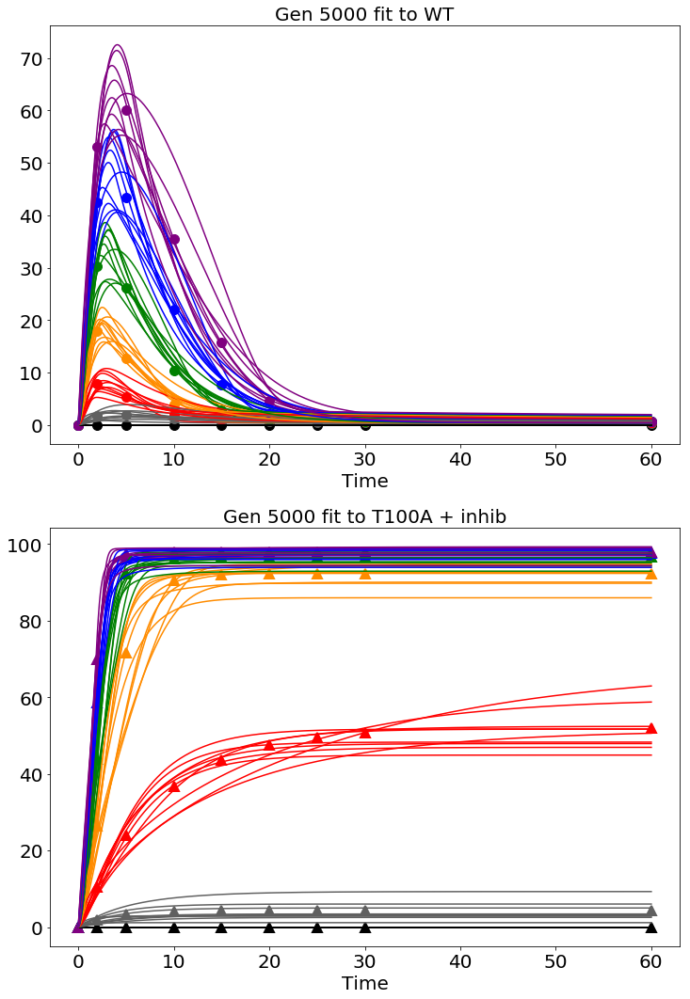

In [62]:
plt_param_behaviors_map2k(map2k_wt_data, map2k_t100a_data, gen, idx_top, plt_top, params_from_file, 
                        params_constants, initals, time)

<Figure size 864x576 with 0 Axes>

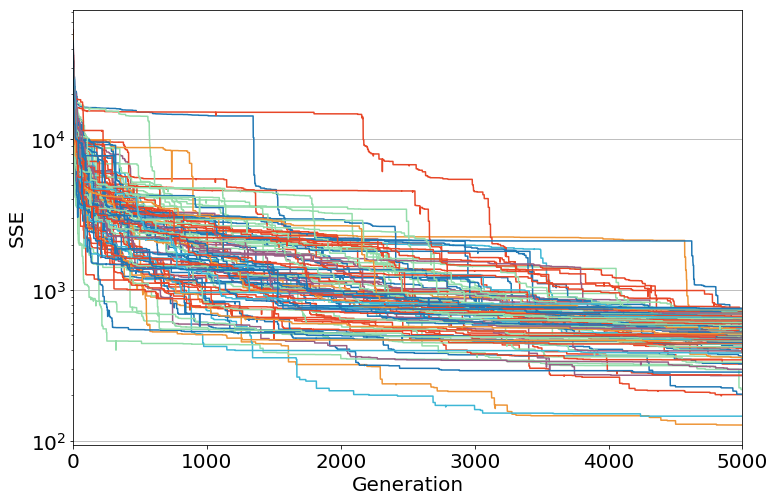

In [63]:
plt_mses_gen(gen,mse)

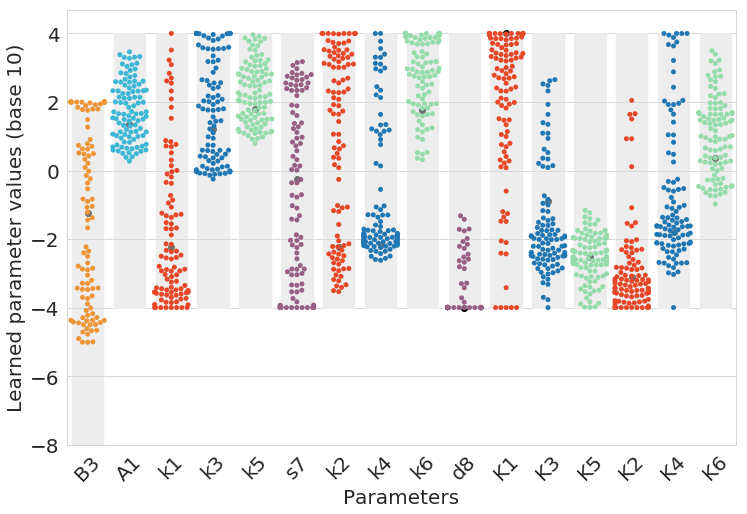

In [19]:
plt.rcParams['figure.figsize'] = [12.0, 8.0]

# positive 3db7d6
# negative ee9537
# hog1 ? 38bf85 or 94ddaa

colors = ['#ee9537', '#3db7d6',
          '#e84728','#1f77b4','#94ddaa','#985f85',
          '#e84728','#1f77b4','#94ddaa','#985f85',
          '#e84728', '#1f77b4','#94ddaa',
          '#e84728','#1f77b4','#94ddaa']

pal = sns.set_palette(colors)

synth_params = [0.05811593884242296, 22.055776494161726, 0.005856531485945982, 16.02375256586352, 62.04163191301923, 0.5829656074894181, 0.006003720077209324, 0.00665660433056748, 59.581534907247836, 0.00010000125349202354, 9999.965236160238, 0.13105979846286905, 0.0030328639545925554, 0.000761857262334227, 0.015697354926997205, 2.3610825732893015]
with sns.axes_style("whitegrid"):
    plt.bar(range(0,len(labelnames)),height=diff,bottom=minimums,align='center',tick_label=labelnames, color='#DCDCDC',alpha = 0.5)
    x = sns.swarmplot(x='param',y='vals', data = df_top_params_log_M)
    x.set_xticklabels(labelnames,rotation=45)
    plt.scatter(range(0,len(labelnames)),np.log10(synth_params), color = 'black')
#     ax.set_yscale("log")
#     ax.set_ylim(0.00001,100000)
#     ax4.set_xticks(locs)
#     plt.xticklabels(labelnames, fontsize=18, rotation=90)
    plt.xlabel('Parameters', fontsize=20)
    plt.ylabel('Learned parameter values (base 10)', fontsize=20)
#     ax.yaxis.set_major_locator(ticker.MultipleLocator(2))

(array([125., 333., 812., 285., 209., 180.,   8.,  13.,   7.,  15.,   3.,
          1.,   5.,   1.,   3.]),
 array([  127.24897602,   876.77088001,  1626.29278401,  2375.814688  ,
         3125.33659199,  3874.85849599,  4624.38039998,  5373.90230397,
         6123.42420797,  6872.94611196,  7622.46801595,  8371.98991995,
         9121.51182394,  9871.03372794, 10620.55563193, 11370.07753592]),
 <a list of 15 Patch objects>)

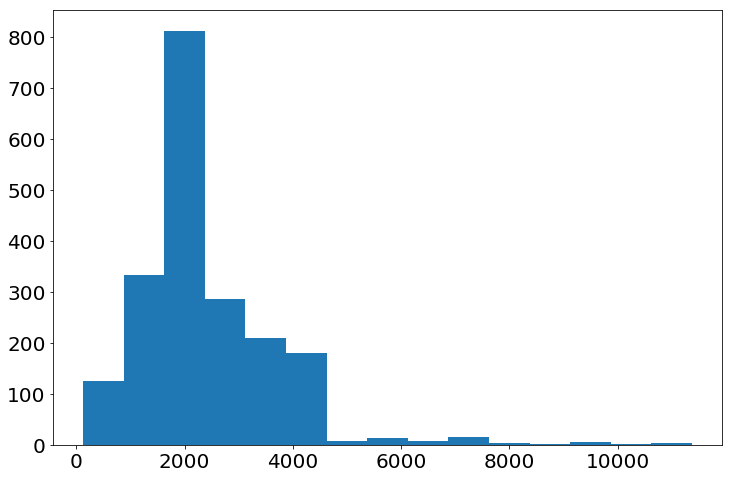

In [20]:
plt.hist(last_mses,bins=15,color='#1f77b4')

## Checking individual parameter sets

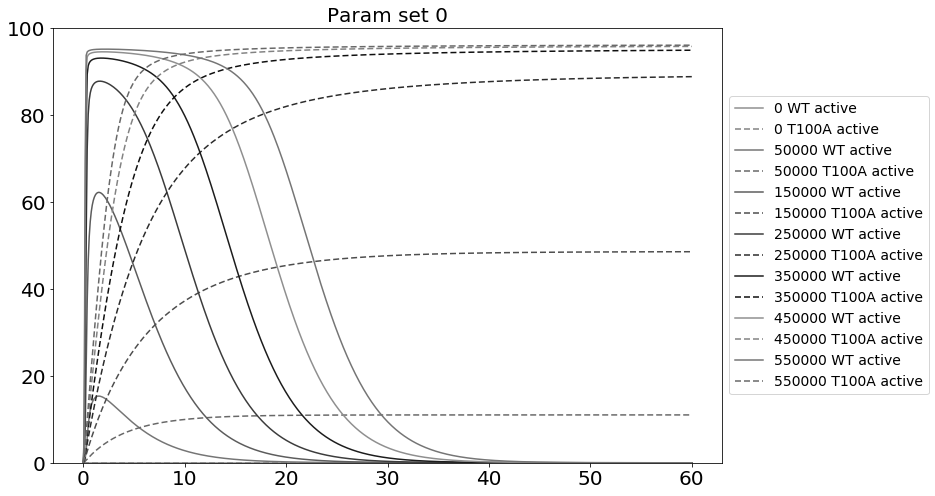

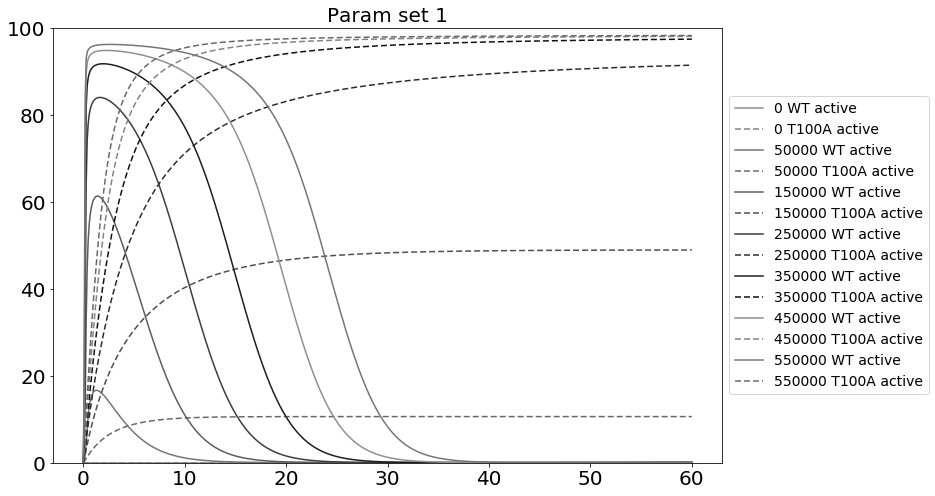

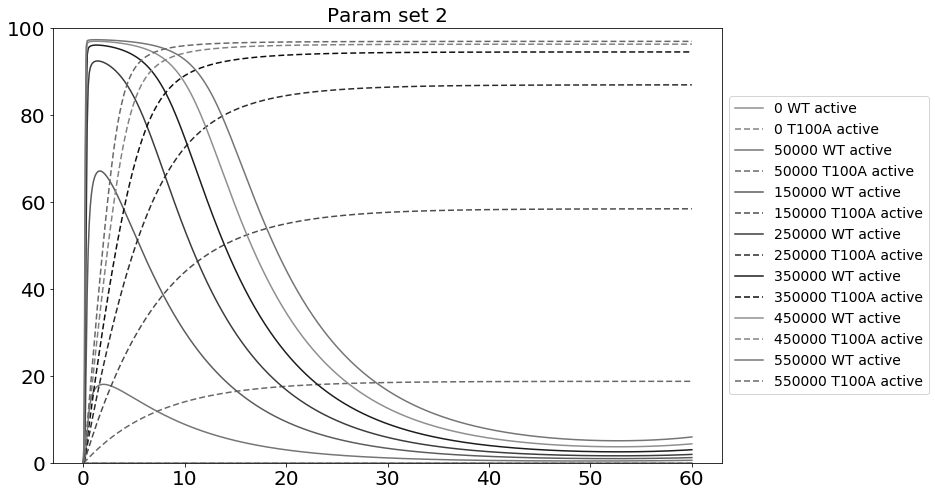

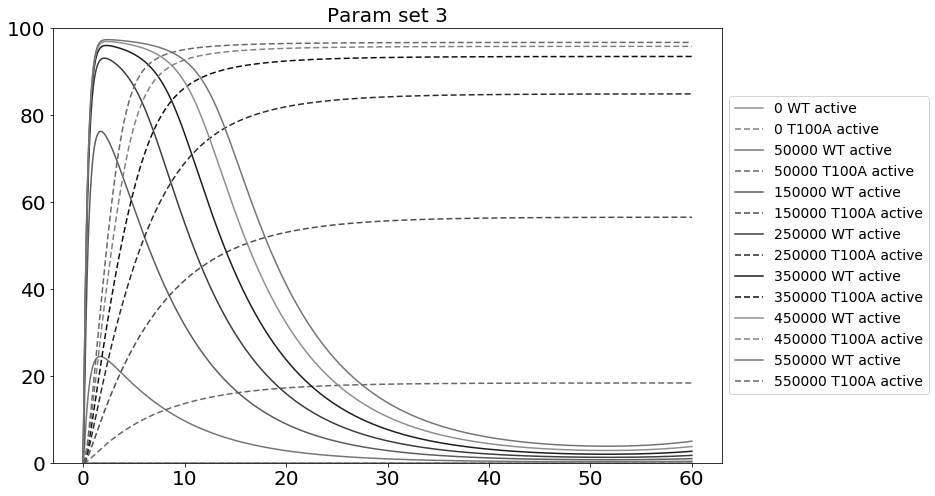

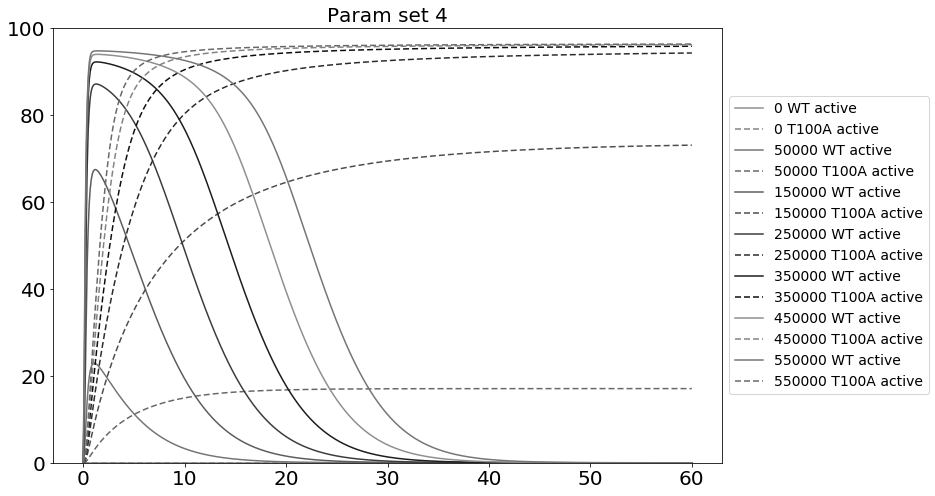

...

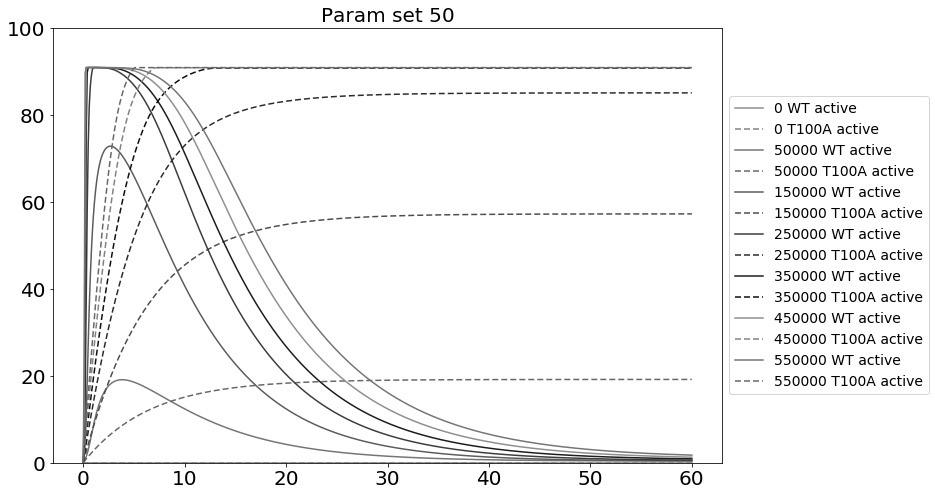

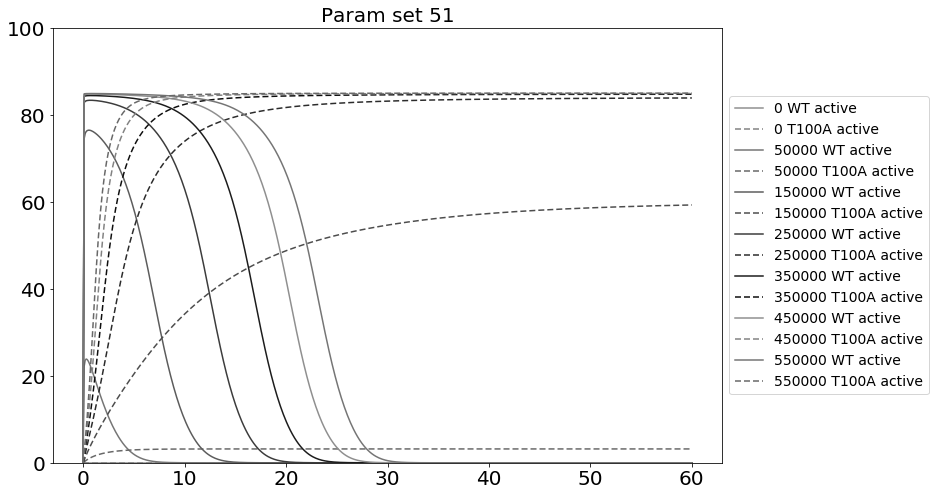

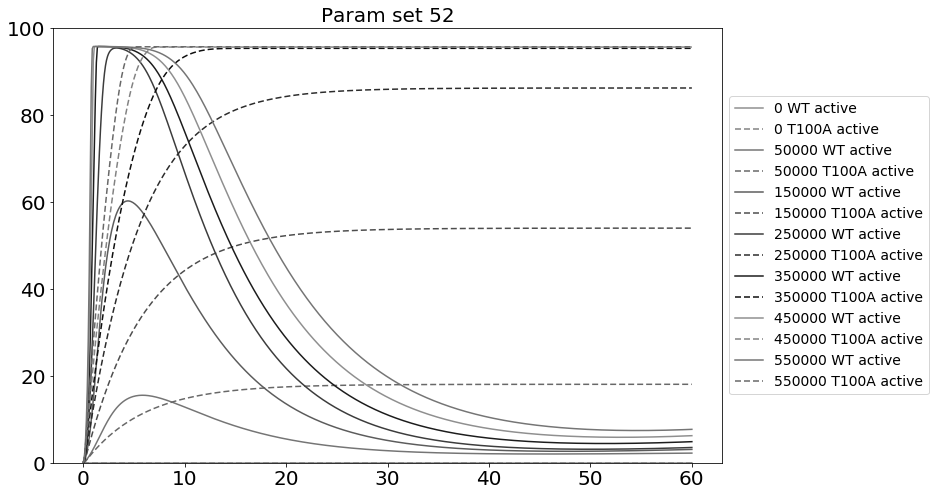

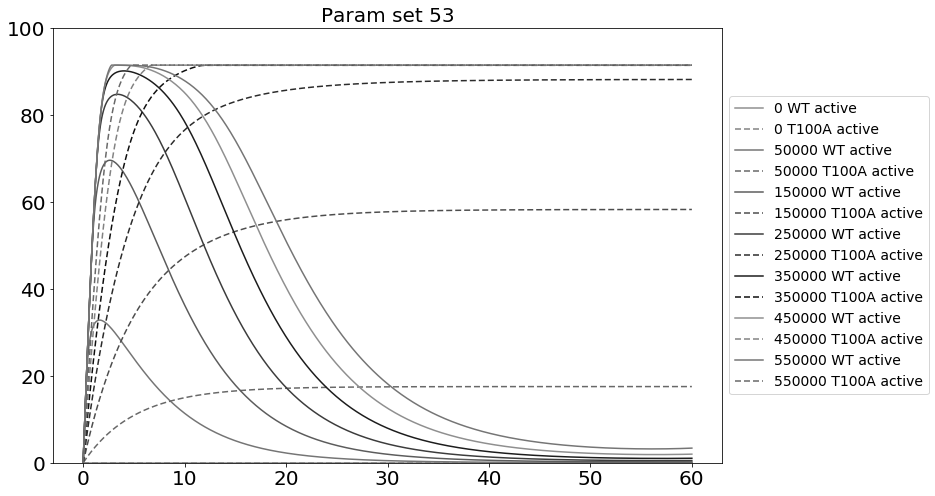

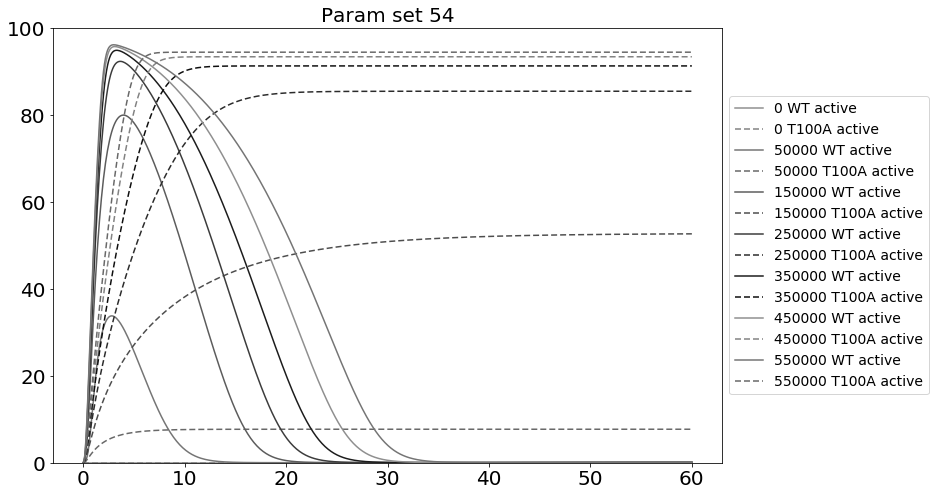

KeyboardInterrupt: 

In [71]:
color_palette = sns.color_palette("rocket", 6)[::-1]

for i, params in enumerate(top_params):
#     beta_1, beta_2, alpha, k1, k2, k3, k4, k5, k6, k7, k8, K_1, K_2, K_3, K_4, K_5, K_6, K_7, K_8, kn, kc = params
#     params = beta_1, beta_2, 0, k1, k2, k3, k4, k5, k6, k7, k8, K_1, K_2, K_3, K_4, K_5, K_6, K_7, K_8, 0, kc
    #plot real data:
#     for idx, (wt_data,t100a_data) in enumerate(zip(mapk_wt_data, mapk_t100a_data)):
#         plt.plot(mapk_time, wt_data, 'o', markersize=10, color=color_palette[idx])
#         plt.plot(mapk_time, t100a_data, '+', mew=2, markersize=10, color=color_palette[idx])
    for idx, signal in enumerate(s):
        data = odeint(b3_a3_1D, initals, time, args=(params_constants[:-1]+[signal], params))
        active = data[:,2]/params_constants[2]*100
        plt.plot(time, active, label=str(signal)+' WT active')
#         plt.plot(time, data[:,4], dashes=[2, 2], label=str(signal)+' X')
        data = simulate_t100a_experiment_a3_1D(initals, params_constants[:-1]+[signal], params, time)
        active = data[:,2]/params_constants[2]*100
        plt.plot(time, active, label=str(signal)+' T100A active', dashes= [4,2])
#         plt.plot(time, data[:,3], label=str(signal)+' MAPKn')
    plt.title(f'Param set {i}')
    plt.legend(bbox_to_anchor=[1, 0.5], loc='center left')
    plt.ylim(0,100)
    plt.show()

# One step delay - a2

## Functions

In [48]:
def b3_a2_1D(initals,t,params_constants,params):
    MAP3K, MAP2K, MAPK, X = initals
    MAP3K_t, MAP2K_t, MAPK_t, s = params_constants
    beta_3, alpha_2, k1, k3, k5, s7, k2, k4, k6, d8, K_1, K_3, K_5, K_2, K_4, K_6 = params

    MAP3K_I = MAP3K_t-MAP3K
    MAP2K_I = MAP2K_t-MAP2K
    MAPK_I = MAPK_t-MAPK
    # Y_I = Y_t-Y

    dMAP3K = (s/(1+X/beta_3)) * (((k1)*MAP3K_I)/(K_1+MAP3K_I)) - (k2*MAP3K/(K_2+MAP3K))
    dMAP2K = (((k3*MAP3K+alpha_2*MAPK)*MAP2K_I)/(K_3+MAP2K_I)) - (k4*MAP2K/(K_4+MAP2K))
    dMAPK = (((k5*MAP2K)*MAPK_I)/(K_5+MAPK_I)) - (k6*MAPK/(K_6+MAPK))
    dX = s7*MAPK - d8*X

    return dMAP3K, dMAP2K, dMAPK, dX

def simulate_wt_experiment(inits, params_constants, learned_params, time):
    # parameters to be learned - inits
    # parameters to be kept constant - params_constants
    # parameters to be learned - learned_params

    #solve odes:
    odes = odeint(b3_a2_1D, inits, time, args=(params_constants, learned_params))

    return odes

def simulate_t100a_experiment(inits, params_constants, learned_params, time):
    # parameters to be learned - inits
    # parameters to be kept constant - params_constants
    # parameters to be learned - learned_params
    beta_3, alpha_2, k1, k3, k5, s7, k2, k4, k6, d8, K_1, K_3, K_5, K_2, K_4, K_6  = learned_params
    learned_params = beta_3, 0, k1, k3, k5, 0, k2, k4, k6, d8, K_1, K_3, K_5, K_2, K_4, K_6
    #solve odes:
    odes = odeint(b3_a2_1D, inits, time, args=(params_constants, learned_params))

    return odes

## Inputs

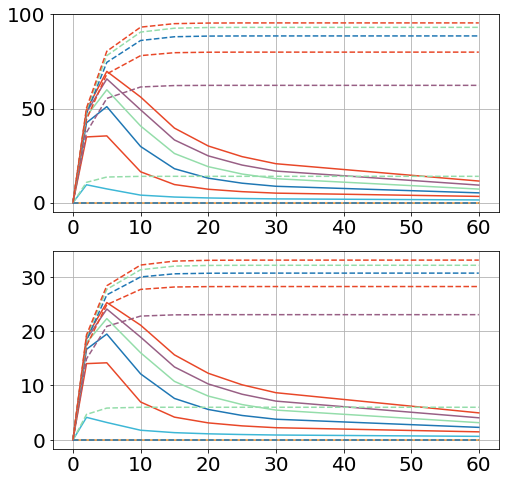

In [49]:
filename = 'C:/Users/sksuzuki/Desktop/killdevil/from/scripts/synth_deg/2_synthdata/map2k/map2k_synthdata/b3_1D_a2_map2k_SYNTH.pickled'
scorefxn_time, scorefxn_data = open_synth_data(filename)
mapk_wt_data = scorefxn_data[0]
mapk_t100a_data = scorefxn_data[1]
map2k_wt_data = scorefxn_data[2]
map2k_t100a_data = scorefxn_data[3]

In [50]:
folder = 'C:/Users/sksuzuki/Desktop/killdevil/from/scripts/181130_b3_1D_a2_map2k_SYNTH/'

gen = 5000
runs = 2000

MAP3K = 0
MAP2K = 0
MAPK = 0
X = 0

MAP3K_t = molarity_conversion(1170)
MAP2K_t = molarity_conversion(2282)
MAPK_t = molarity_conversion(5984)


s = [0, 50000, 150000, 250000, 350000, 450000, 550000]


labelnames = ['B3', 'A2',
              'k1', 'k3', 'k5', 's7',
              'k2', 'k4', 'k6', 'd8',
              'K1', 'K3', 'K5', 
              'K2', 'K4', 'K6'
                ]

minimums = [-8, -4,
    -4, -4, -4, -4,
    -4, -4, -4, -4,
    -4, -4, -4,
    -4, -4, -4]

maximums = [ 2, 4,
    4, 4, 4, 4,
    4, 4, 4, 4,
    4, 4, 4,
    4, 4, 4]
diff = np.asarray(maximums)-np.asarray(minimums)

# fb = 1
# t100a_fb = 0

initals = [MAP3K, MAP2K, MAPK, X]
params_constants = [MAP3K_t, MAP2K_t, MAPK_t, s] 
    
dt = 0.1
steps = 600
time = np.linspace(0,dt*steps,steps)

idx_closest_time_points = get_closest_tps(mapk_time,time)

## Gather simulated data

In [51]:
idx_top, top_params, top, plt_top, new_params, params_from_file, mse, last_mses = gather_simulated_data(folder, gen, runs)
df_top_params = pd.DataFrame(top_params)
df_top_params.columns = labelnames
df_top_params_log = df_top_params.apply(np.log10)
df_top_params_log_M = df_top_params_log.melt(var_name='param', value_name='vals')

Best MSE: 24.717764526108606
Mean MSE of top 5%: 162.41215001332242


## Plot

# of unstable WT experiments: 0 of 60
# of unstable T100A experiments: 0 of 60


<Figure size 864x576 with 0 Axes>

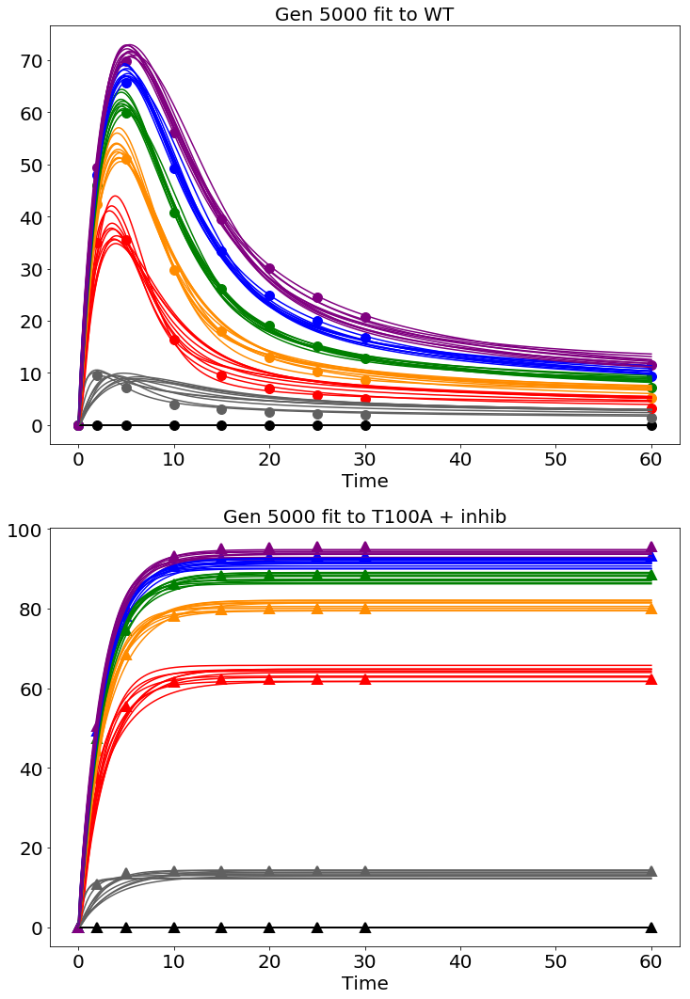

In [52]:
plt_param_behaviors(mapk_wt_data, mapk_t100a_data, gen, idx_top, plt_top, params_from_file, 
                        params_constants, initals, time)

# of unstable WT experiments: 0 of 60
# of unstable T100A experiments: 0 of 60


<Figure size 864x576 with 0 Axes>

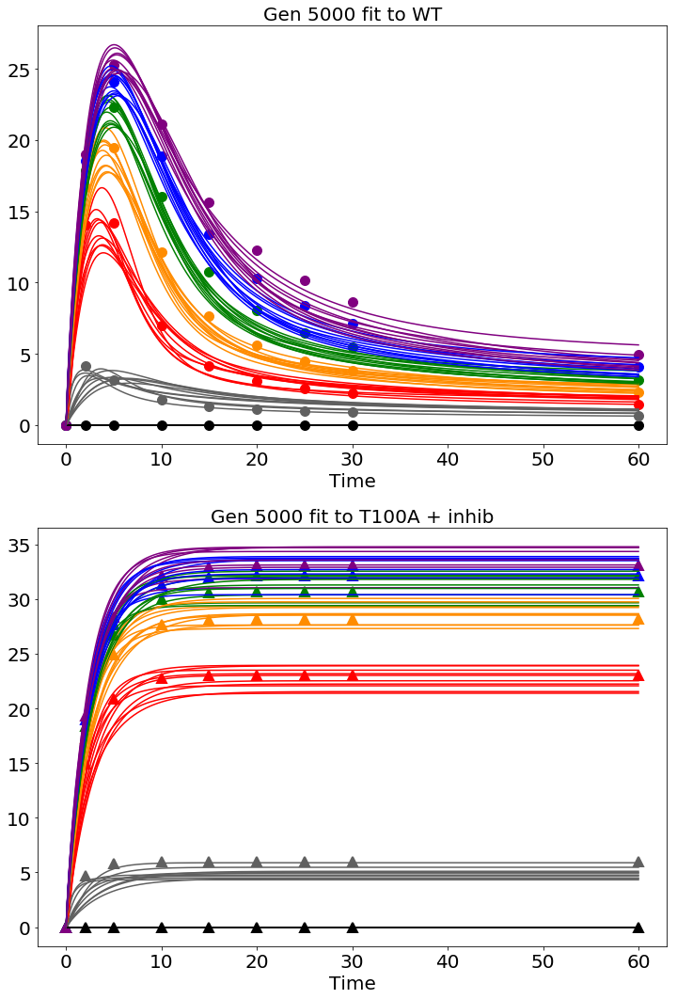

In [53]:
plt_param_behaviors_map2k(map2k_wt_data, map2k_t100a_data, gen, idx_top, plt_top, params_from_file, 
                        params_constants, initals, time)

<Figure size 864x576 with 0 Axes>

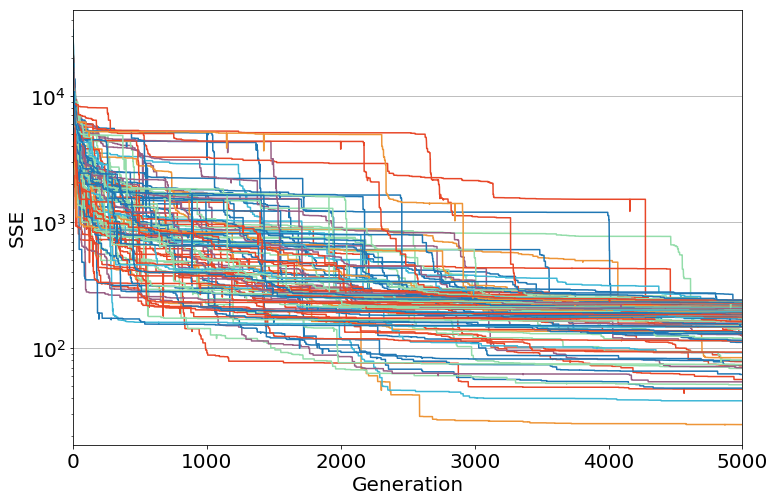

In [54]:
plt_mses_gen(gen,mse)

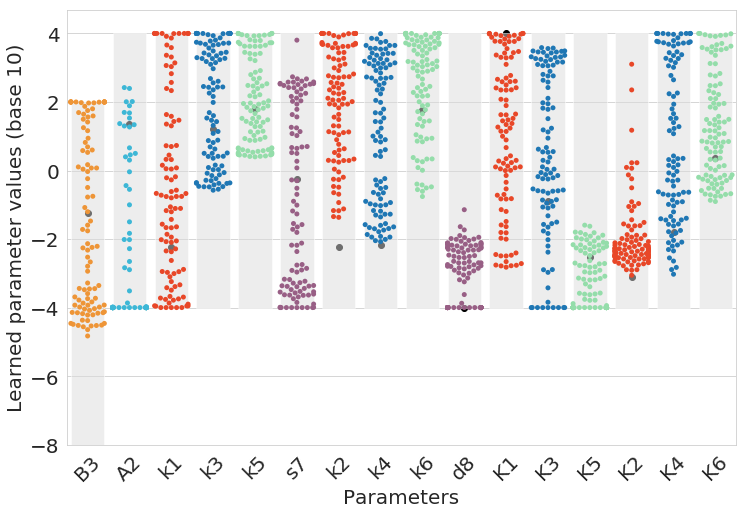

In [55]:
plt.rcParams['figure.figsize'] = [12.0, 8.0]

# positive 3db7d6
# negative ee9537
# hog1 ? 38bf85 or 94ddaa

colors = ['#ee9537', '#3db7d6',
          '#e84728','#1f77b4','#94ddaa','#985f85',
          '#e84728','#1f77b4','#94ddaa','#985f85',
          '#e84728', '#1f77b4','#94ddaa',
          '#e84728','#1f77b4','#94ddaa']

pal = sns.set_palette(colors)

# synth_params = [0.05811593884242296, 22.055776494161726, 0.005856531485945982, 16.02375256586352, 62.04163191301923, 0.5829656074894181, 0.006003720077209324, 0.00665660433056748, 59.581534907247836, 0.00010000125349202354, 9999.965236160238, 0.13105979846286905, 0.0030328639545925554, 0.000761857262334227, 0.015697354926997205, 2.3610825732893015]
with sns.axes_style("whitegrid"):
    plt.bar(range(0,len(labelnames)),height=diff,bottom=minimums,align='center',tick_label=labelnames, color='#DCDCDC',alpha = 0.5)
    x = sns.swarmplot(x='param',y='vals', data = df_top_params_log_M)
    x.set_xticklabels(labelnames,rotation=45)
    plt.scatter(range(0,len(labelnames)),np.log10(synth_params), color = 'black')
#     ax.set_yscale("log")
#     ax.set_ylim(0.00001,100000)
#     ax4.set_xticks(locs)
#     plt.xticklabels(labelnames, fontsize=18, rotation=90)
    plt.xlabel('Parameters', fontsize=20)
    plt.ylabel('Learned parameter values (base 10)', fontsize=20)
#     ax.yaxis.set_major_locator(ticker.MultipleLocator(2))

(array([1.032e+03, 8.580e+02, 7.400e+01, 3.100e+01, 1.000e+00, 0.000e+00,
        0.000e+00, 1.000e+00, 1.000e+00, 0.000e+00, 1.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 1.000e+00]),
 array([  24.71776453,  641.11812208, 1257.51847963, 1873.91883719,
        2490.31919474, 3106.71955229, 3723.11990985, 4339.5202674 ,
        4955.92062495, 5572.32098251, 6188.72134006, 6805.12169761,
        7421.52205517, 8037.92241272, 8654.32277027, 9270.72312783]),
 <a list of 15 Patch objects>)

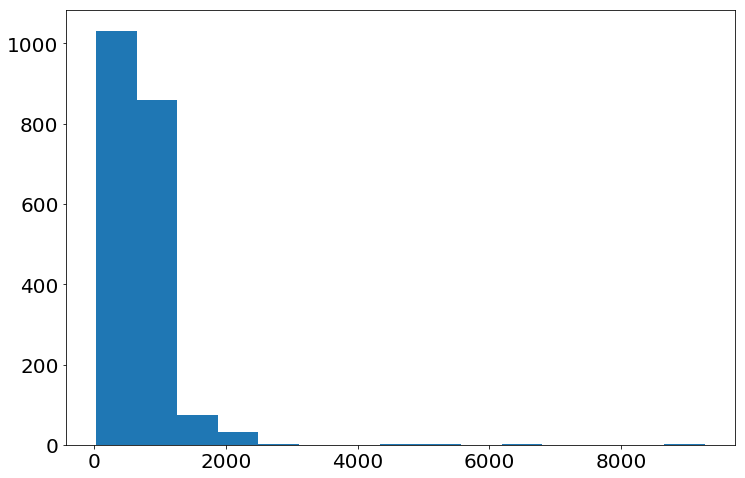

In [56]:
plt.hist(last_mses,bins=15,color='#1f77b4')

## Checking individual parameter sets

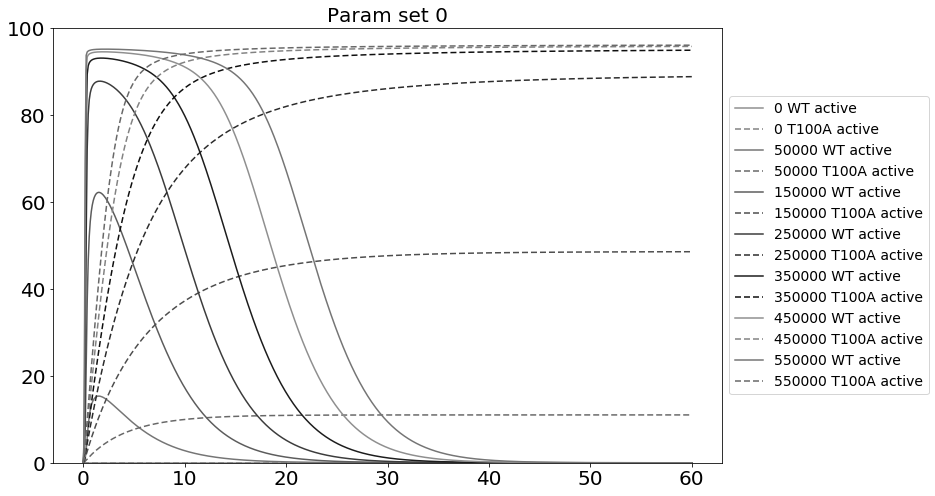

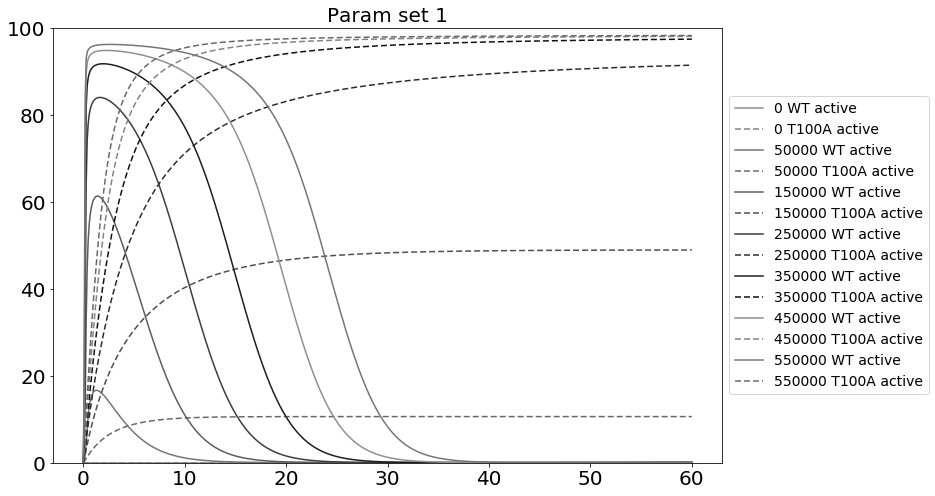

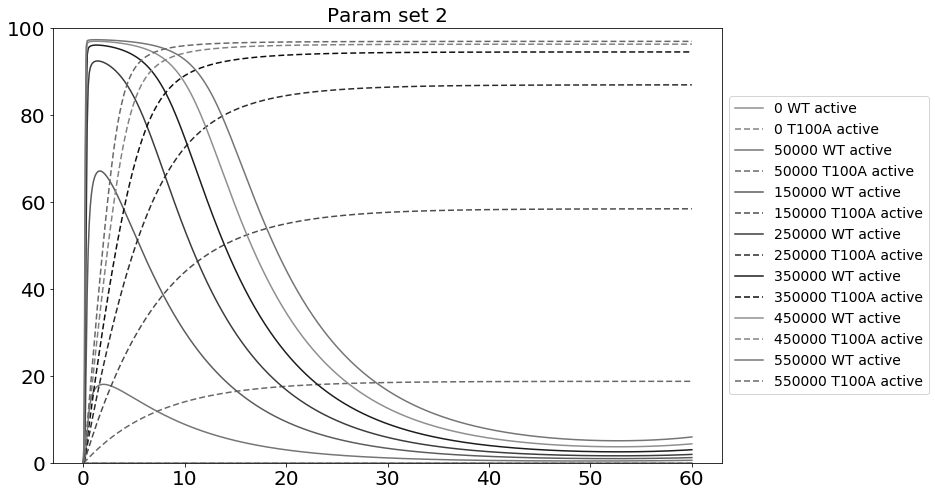

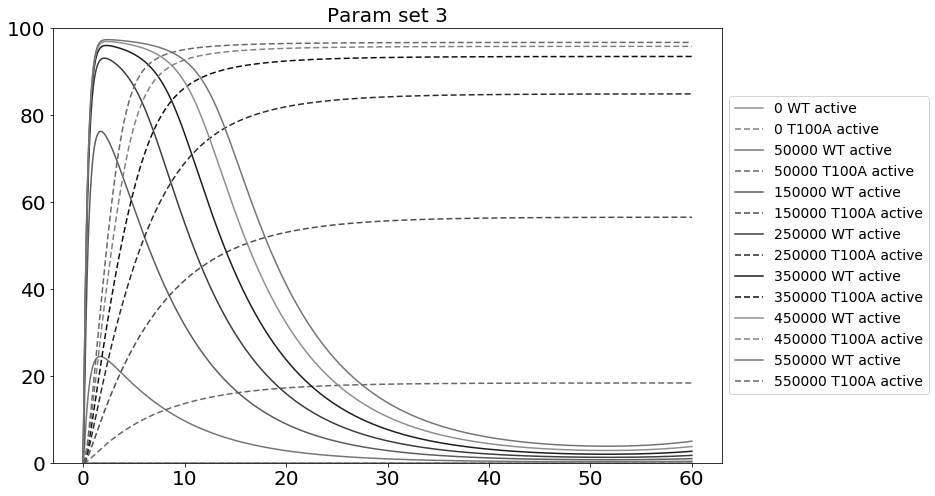

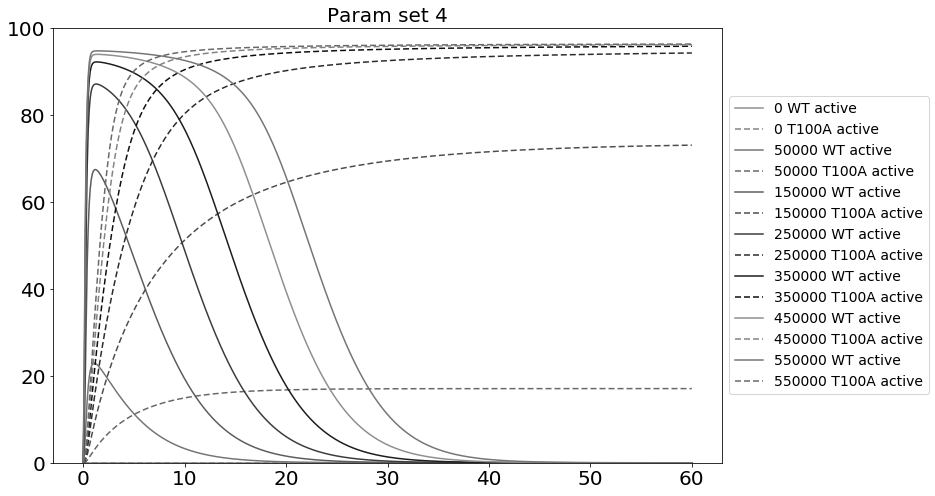

...

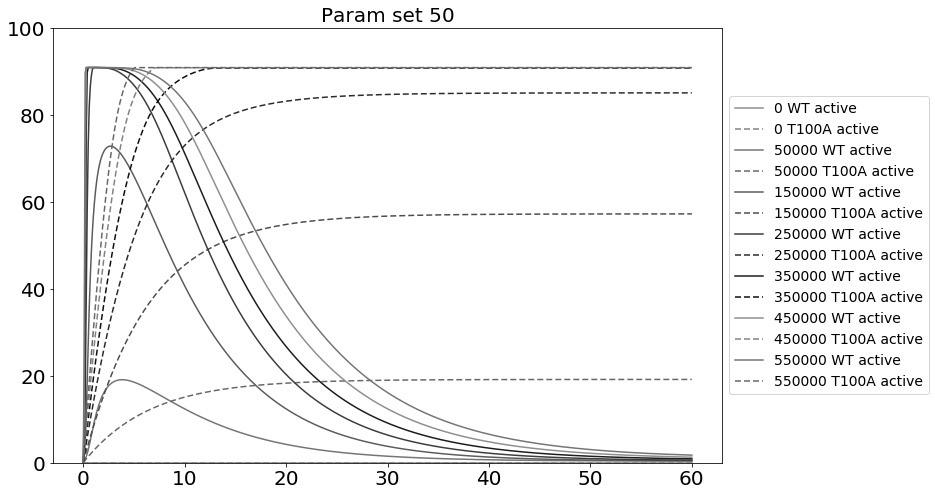

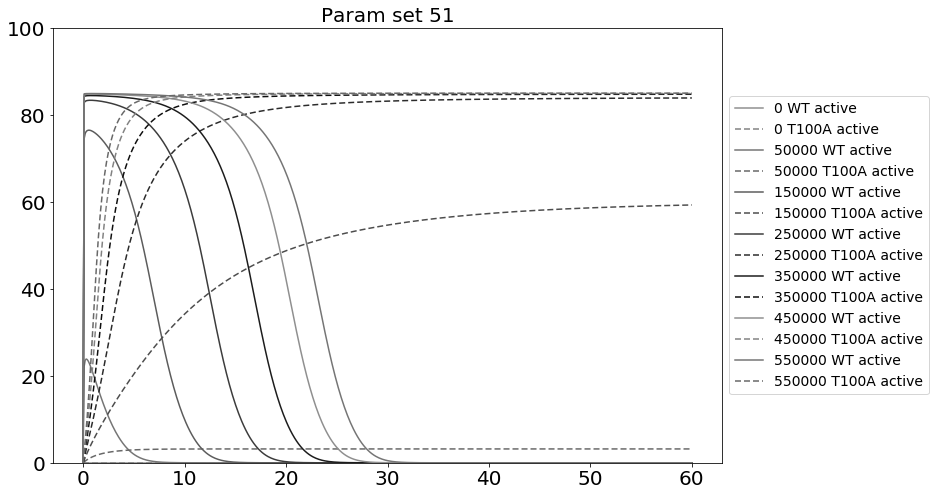

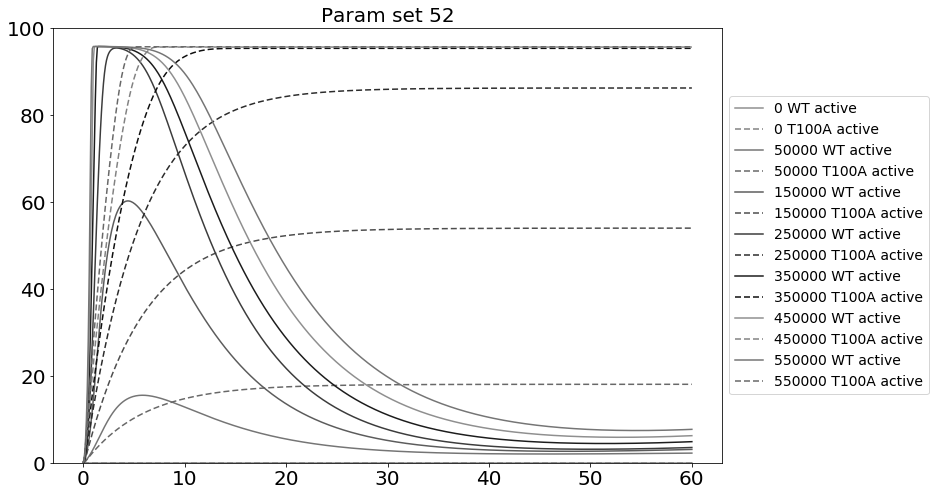

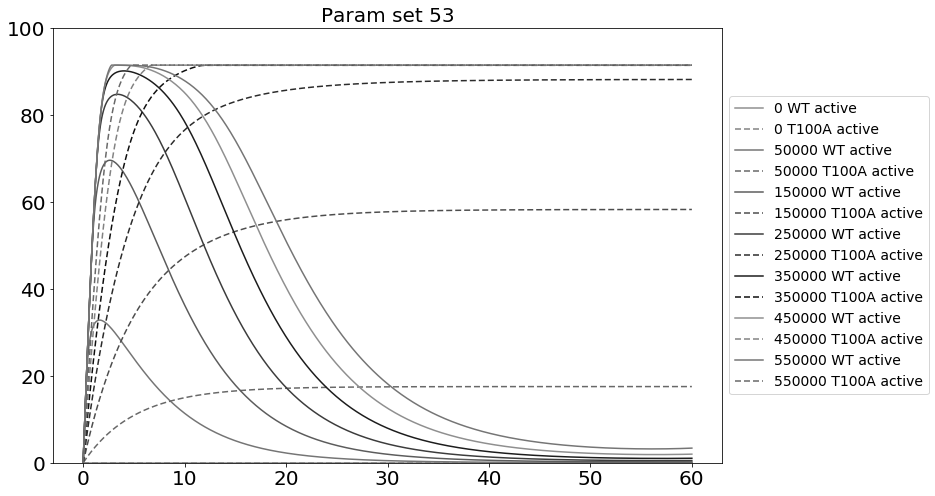

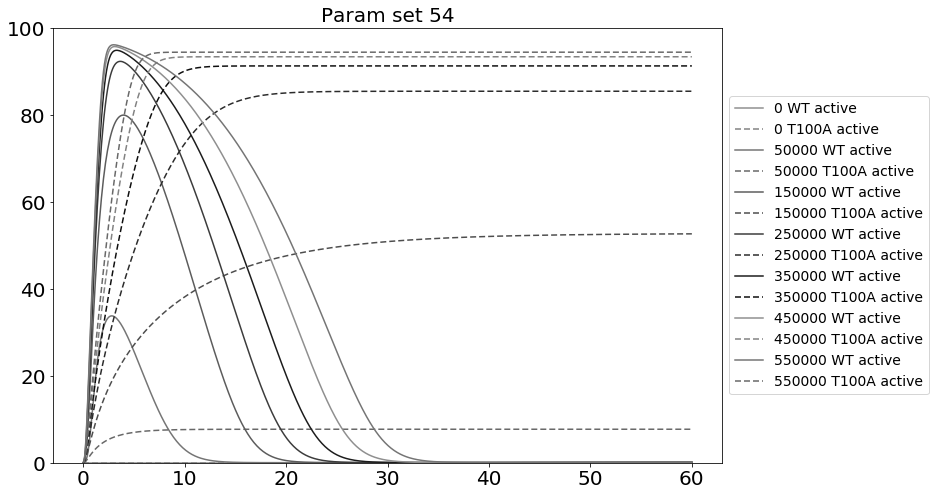

KeyboardInterrupt: 

In [71]:
color_palette = sns.color_palette("rocket", 6)[::-1]

for i, params in enumerate(top_params):
#     beta_1, beta_2, alpha, k1, k2, k3, k4, k5, k6, k7, k8, K_1, K_2, K_3, K_4, K_5, K_6, K_7, K_8, kn, kc = params
#     params = beta_1, beta_2, 0, k1, k2, k3, k4, k5, k6, k7, k8, K_1, K_2, K_3, K_4, K_5, K_6, K_7, K_8, 0, kc
    #plot real data:
#     for idx, (wt_data,t100a_data) in enumerate(zip(mapk_wt_data, mapk_t100a_data)):
#         plt.plot(mapk_time, wt_data, 'o', markersize=10, color=color_palette[idx])
#         plt.plot(mapk_time, t100a_data, '+', mew=2, markersize=10, color=color_palette[idx])
    for idx, signal in enumerate(s):
        data = odeint(b3_a3_1D, initals, time, args=(params_constants[:-1]+[signal], params))
        active = data[:,2]/params_constants[2]*100
        plt.plot(time, active, label=str(signal)+' WT active')
#         plt.plot(time, data[:,4], dashes=[2, 2], label=str(signal)+' X')
        data = simulate_t100a_experiment_a3_1D(initals, params_constants[:-1]+[signal], params, time)
        active = data[:,2]/params_constants[2]*100
        plt.plot(time, active, label=str(signal)+' T100A active', dashes= [4,2])
#         plt.plot(time, data[:,3], label=str(signal)+' MAPKn')
    plt.title(f'Param set {i}')
    plt.legend(bbox_to_anchor=[1, 0.5], loc='center left')
    plt.ylim(0,100)
    plt.show()

# One step delay - a3

## Functions

In [37]:
def b3_a3_1D(initals,t,params_constants,params):
    MAP3K, MAP2K, MAPK, X = initals
    MAP3K_t, MAP2K_t, MAPK_t, s = params_constants
    beta_3, alpha_3, k1, k3, k5, s7, k2, k4, k6, d8, K_1, K_3, K_5, K_2, K_4, K_6 = params

    MAP3K_I = MAP3K_t-MAP3K
    MAP2K_I = MAP2K_t-MAP2K
    MAPK_I = MAPK_t-MAPK
    # Y_I = Y_t-Y

    dMAP3K = (s/(1+X/beta_3)) * (((k1+alpha_3*MAPK)*MAP3K_I)/(K_1+MAP3K_I)) - (k2*MAP3K/(K_2+MAP3K))
    dMAP2K = (((k3*MAP3K)*MAP2K_I)/(K_3+MAP2K_I)) - (k4*MAP2K/(K_4+MAP2K))
    dMAPK = (((k5*MAP2K)*MAPK_I)/(K_5+MAPK_I)) - (k6*MAPK/(K_6+MAPK))
    dX = s7*MAPK - d8*X
    # dY = ((k9*X*Y_I) / (K_9+Y_I)) - (k10*Y/(K_10+Y))

    return dMAP3K, dMAP2K, dMAPK, dX

def simulate_wt_experiment(inits, params_constants, learned_params, time):
    # parameters to be learned - inits
    # parameters to be kept constant - params_constants
    # parameters to be learned - learned_params

    #solve odes:
    odes = odeint(b3_a3_1D, inits, time, args=(params_constants, learned_params))

    return odes

def simulate_t100a_experiment(inits, params_constants, learned_params, time):
    # parameters to be learned - inits
    # parameters to be kept constant - params_constants
    # parameters to be learned - learned_params
    beta_3, alpha_3, k1, k3, k5, s7, k2, k4, k6, d8, K_1, K_3, K_5, K_2, K_4, K_6  = learned_params
    learned_params = beta_3, 0, k1, k3, k5, 0, k2, k4, k6, d8, K_1, K_3, K_5, K_2, K_4, K_6
    #solve odes:
    odes = odeint(b3_a3_1D, inits, time, args=(params_constants, learned_params))

    return odes

## Inputs

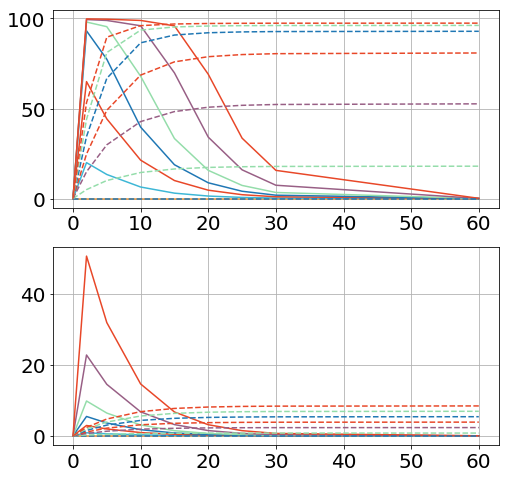

In [38]:
filename = 'C:/Users/sksuzuki/Desktop/killdevil/from/scripts/synth_deg/2_synthdata/map2k/map2k_synthdata/b3_1D_a3_map2k_SYNTH.pickled'
scorefxn_time, scorefxn_data = open_synth_data(filename)
mapk_wt_data = scorefxn_data[0]
mapk_t100a_data = scorefxn_data[1]
map2k_wt_data = scorefxn_data[2]
map2k_t100a_data = scorefxn_data[3]

In [39]:
folder = 'C:/Users/sksuzuki/Desktop/killdevil/from/scripts/181130_b3_1D_a3_map2k_SYNTH/'

gen = 5000
runs = 2000

MAP3K = 0
MAP2K = 0
MAPK = 0
X = 0

MAP3K_t = molarity_conversion(1170)
MAP2K_t = molarity_conversion(2282)
MAPK_t = molarity_conversion(5984)


s = [0, 50000, 150000, 250000, 350000, 450000, 550000]


labelnames = ['B3', 'A3',
              'k1', 'k3', 'k5', 's7',
              'k2', 'k4', 'k6', 'd8',
              'K1', 'K3', 'K5', 
              'K2', 'K4', 'K6'
                ]

minimums = [-8, -4,
    -4, -4, -4, -4,
    -4, -4, -4, -4,
    -4, -4, -4,
    -4, -4, -4]

maximums = [ 2, 4,
    4, 4, 4, 4,
    4, 4, 4, 4,
    4, 4, 4,
    4, 4, 4]
diff = np.asarray(maximums)-np.asarray(minimums)

# fb = 1
# t100a_fb = 0

initals = [MAP3K, MAP2K, MAPK, X]
params_constants = [MAP3K_t, MAP2K_t, MAPK_t, s] 
    
dt = 0.1
steps = 600
time = np.linspace(0,dt*steps,steps)

## Gather simulated data

In [40]:
idx_top, top_params, top, plt_top, new_params, params_from_file, mse, last_mses_aN_0D = gather_simulated_data(folder, gen, runs)
df_top_params = pd.DataFrame(top_params)
df_top_params.columns = labelnames
df_top_params_log = df_top_params.apply(np.log10)
df_top_params_log_M = df_top_params_log.melt(var_name='param', value_name='vals')

Best MSE: 36.01947547983899
Mean MSE of top 5%: 292.9182220249138


## Plot

# of unstable WT experiments: 0 of 60
# of unstable T100A experiments: 0 of 60


<Figure size 864x576 with 0 Axes>

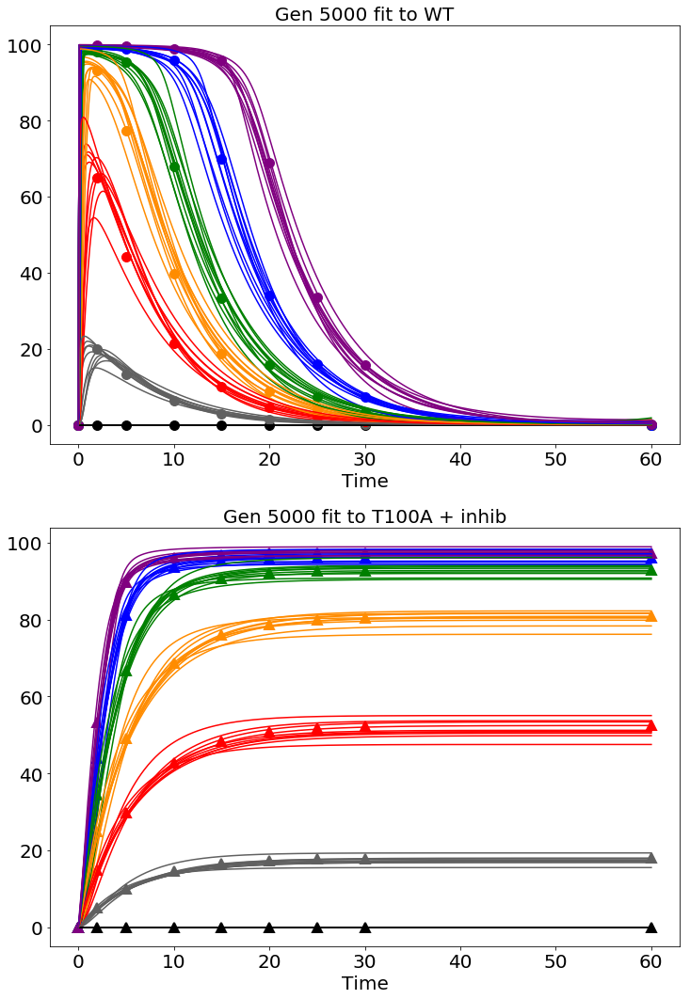

In [46]:
plt_param_behaviors(mapk_wt_data, mapk_t100a_data, gen, idx_top, plt_top, params_from_file, 
                        params_constants, initals, time)

# of unstable WT experiments: 0 of 60
# of unstable T100A experiments: 0 of 60


<Figure size 864x576 with 0 Axes>

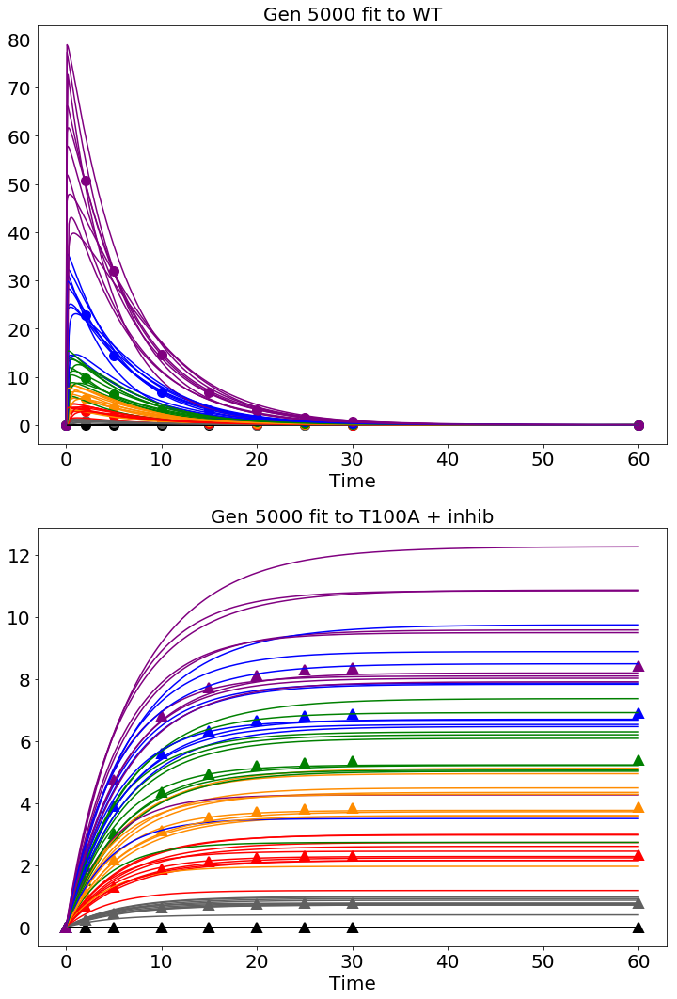

In [47]:
plt_param_behaviors_map2k(map2k_wt_data, map2k_t100a_data, gen, idx_top, plt_top, params_from_file, 
                        params_constants, initals, time)

<Figure size 864x576 with 0 Axes>

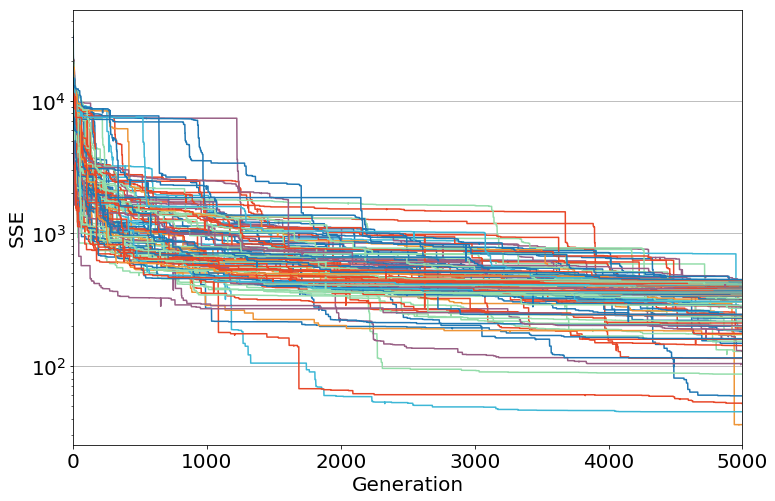

In [43]:
plt_mses_gen(gen,mse)

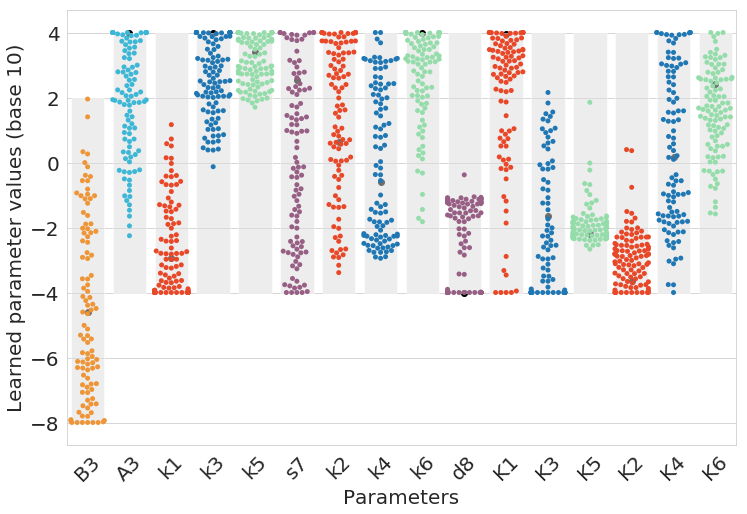

In [44]:
plt.rcParams['figure.figsize'] = [12.0, 8.0]

# positive 3db7d6
# negative ee9537
# hog1 ? 38bf85 or 94ddaa

colors = ['#ee9537', '#3db7d6',
          '#e84728','#1f77b4','#94ddaa','#985f85',
          '#e84728','#1f77b4','#94ddaa','#985f85',
          '#e84728', '#1f77b4','#94ddaa',
          '#e84728','#1f77b4','#94ddaa']

pal = sns.set_palette(colors)

synth_params = [2.4731614187515633e-05, 9999.991813357154, 0.0011335548854895436, 9999.99999289708, 2438.5185506917014, 339.62212256030864, 4.317287169165386, 0.24936410626079056, 9947.169579078321, 0.00010001137720955296, 9243.430162078077, 0.02231479883072405, 0.006340336311866502, 0.00021884302168209783, 1.528239324584821, 256.91831226630086]

with sns.axes_style("whitegrid"):
    plt.bar(range(0,len(labelnames)),height=diff,bottom=minimums,align='center',tick_label=labelnames, color='#DCDCDC',alpha = 0.5)
    x = sns.swarmplot(x='param',y='vals', data = df_top_params_log_M)
    x.set_xticklabels(labelnames,rotation=45)
    plt.scatter(range(0,len(labelnames)),np.log10(synth_params), color = 'black')
#     ax.set_yscale("log")
#     ax.set_ylim(0.00001,100000)
#     ax4.set_xticks(locs)
#     plt.xticklabels(labelnames, fontsize=18, rotation=90)
    plt.xlabel('Parameters', fontsize=20)
    plt.ylabel('Learned parameter values (base 10)', fontsize=20)
#     ax.yaxis.set_major_locator(ticker.MultipleLocator(2))

(array([125., 333., 812., 285., 209., 180.,   8.,  13.,   7.,  15.,   3.,
          1.,   5.,   1.,   3.]),
 array([  127.24897602,   876.77088001,  1626.29278401,  2375.814688  ,
         3125.33659199,  3874.85849599,  4624.38039998,  5373.90230397,
         6123.42420797,  6872.94611196,  7622.46801595,  8371.98991995,
         9121.51182394,  9871.03372794, 10620.55563193, 11370.07753592]),
 <a list of 15 Patch objects>)

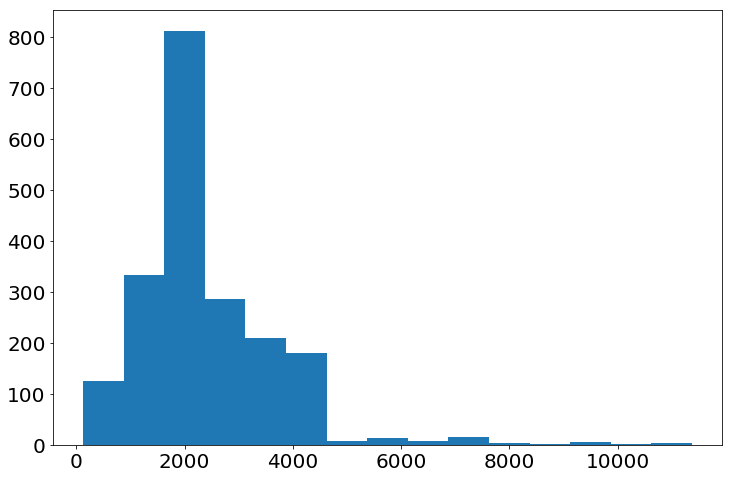

In [45]:
plt.hist(last_mses,bins=15,color='#1f77b4')

## Checking individual parameter sets

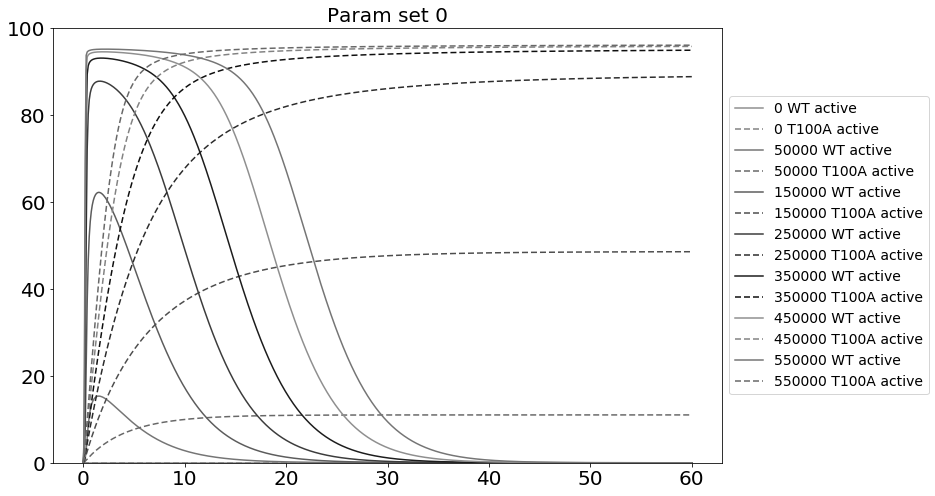

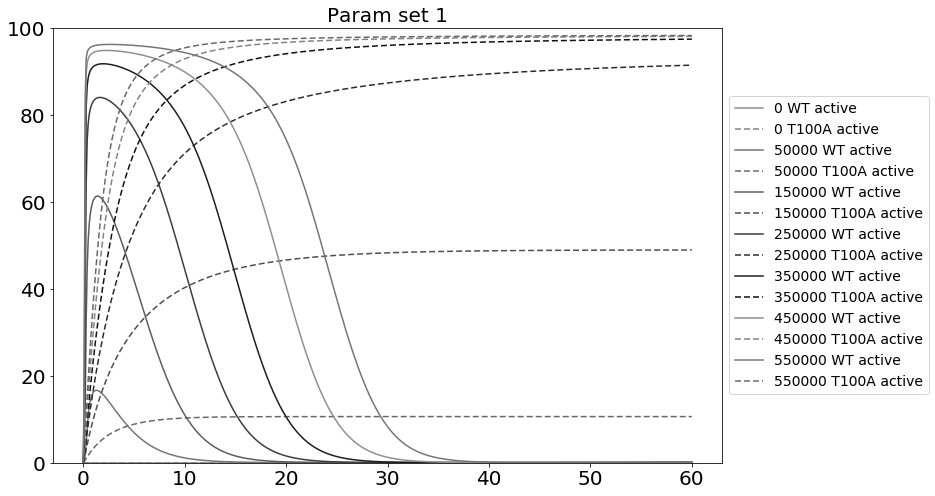

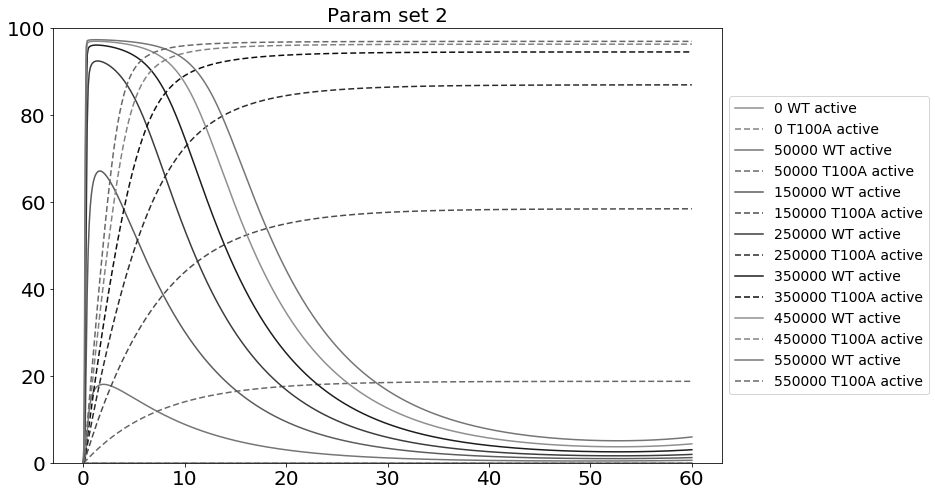

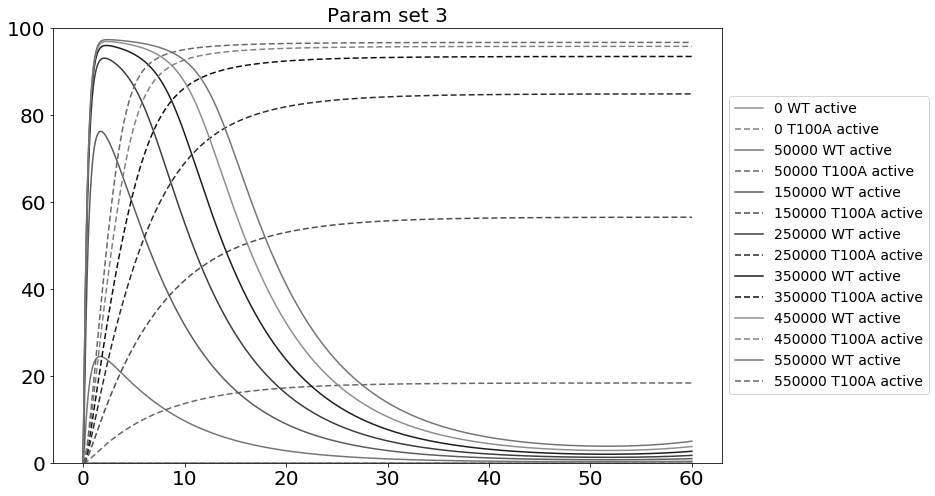

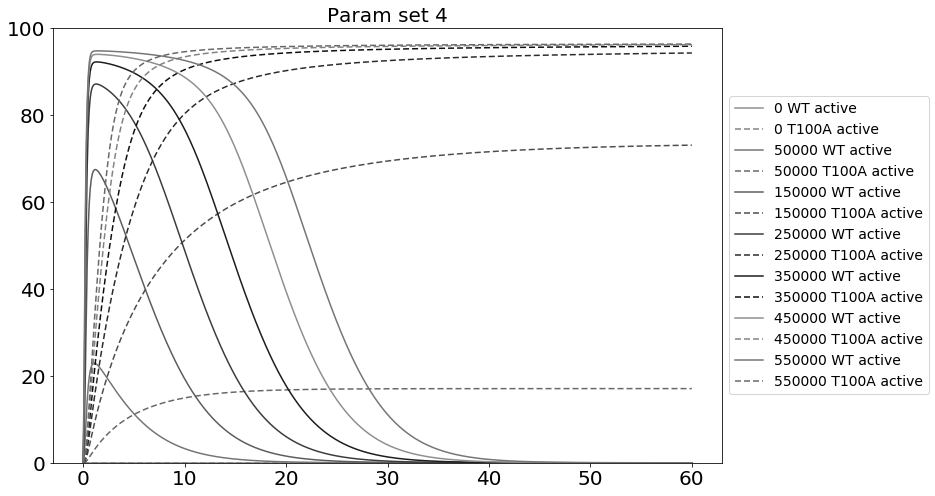

...

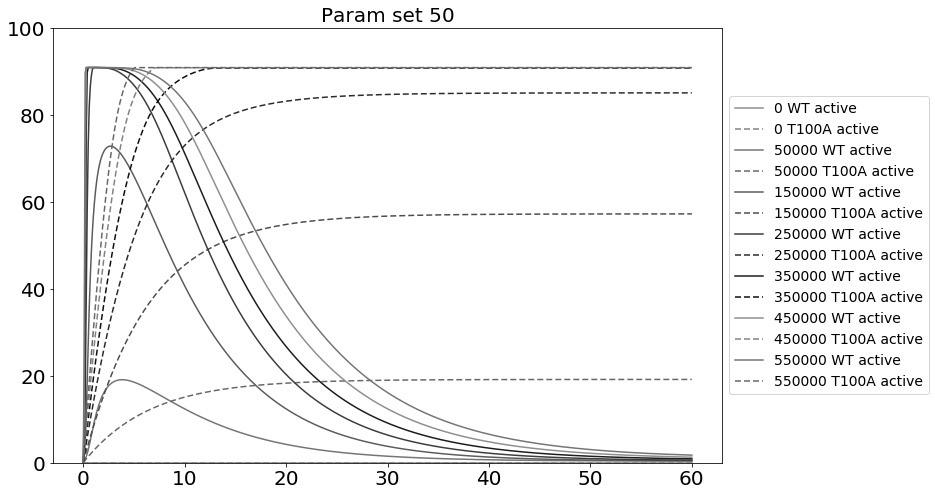

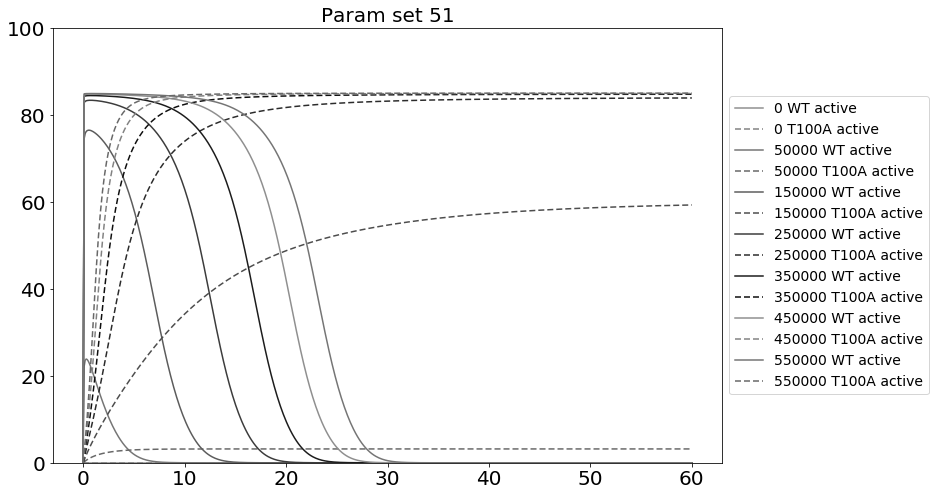

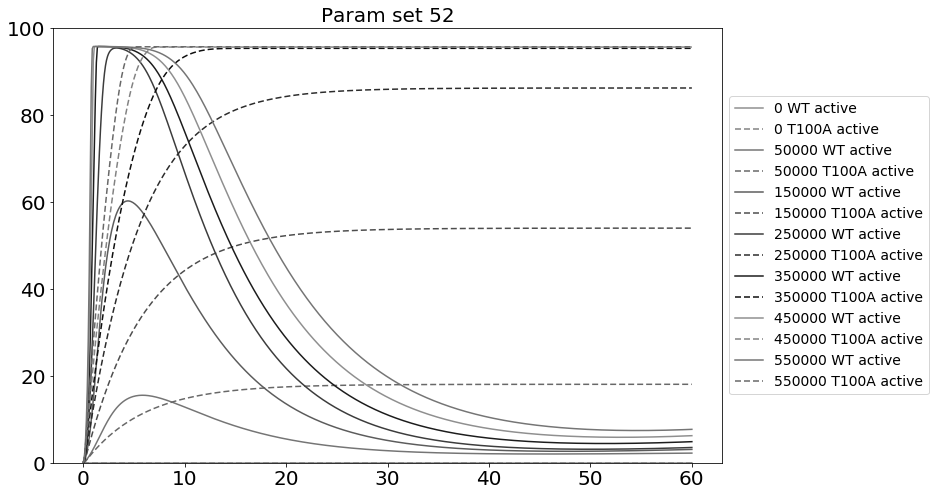

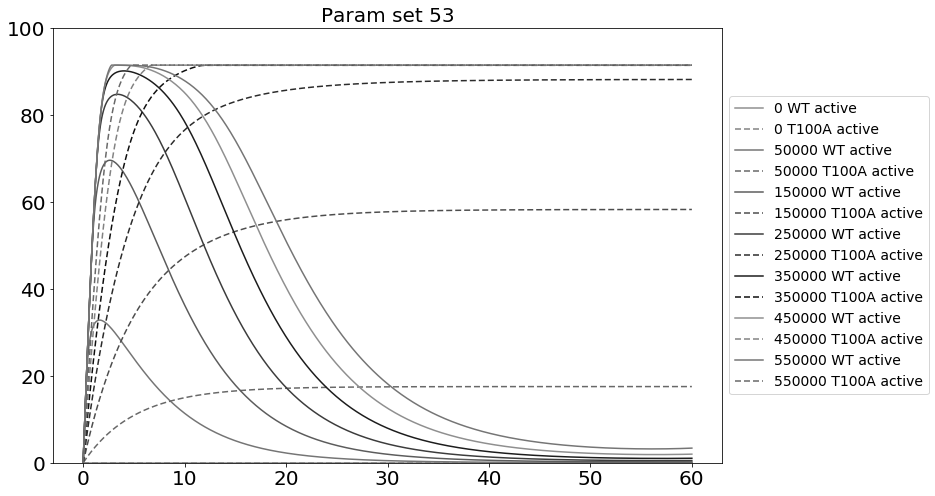

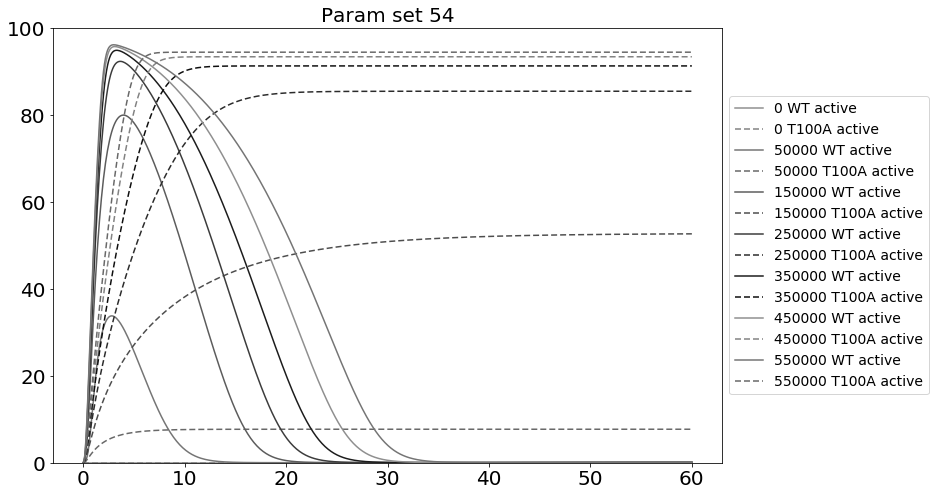

KeyboardInterrupt: 

In [71]:
color_palette = sns.color_palette("rocket", 6)[::-1]

for i, params in enumerate(top_params):
#     beta_1, beta_2, alpha, k1, k2, k3, k4, k5, k6, k7, k8, K_1, K_2, K_3, K_4, K_5, K_6, K_7, K_8, kn, kc = params
#     params = beta_1, beta_2, 0, k1, k2, k3, k4, k5, k6, k7, k8, K_1, K_2, K_3, K_4, K_5, K_6, K_7, K_8, 0, kc
    #plot real data:
#     for idx, (wt_data,t100a_data) in enumerate(zip(mapk_wt_data, mapk_t100a_data)):
#         plt.plot(mapk_time, wt_data, 'o', markersize=10, color=color_palette[idx])
#         plt.plot(mapk_time, t100a_data, '+', mew=2, markersize=10, color=color_palette[idx])
    for idx, signal in enumerate(s):
        data = odeint(b3_a3_1D, initals, time, args=(params_constants[:-1]+[signal], params))
        active = data[:,2]/params_constants[2]*100
        plt.plot(time, active, label=str(signal)+' WT active')
#         plt.plot(time, data[:,4], dashes=[2, 2], label=str(signal)+' X')
        data = simulate_t100a_experiment_a3_1D(initals, params_constants[:-1]+[signal], params, time)
        active = data[:,2]/params_constants[2]*100
        plt.plot(time, active, label=str(signal)+' T100A active', dashes= [4,2])
#         plt.plot(time, data[:,3], label=str(signal)+' MAPKn')
    plt.title(f'Param set {i}')
    plt.legend(bbox_to_anchor=[1, 0.5], loc='center left')
    plt.ylim(0,100)
    plt.show()